Using network from R4, use LRFinder module from https://www.jeremyjordan.me/nn-learning-rate/ to find better learning rates.

In [1]:
from keras.applications.resnet50 import ResNet50
from keras.applications.resnet50 import preprocess_input, decode_predictions
from keras.preprocessing import image
from keras.models import Model
from keras.layers import Conv2D, UpSampling2D, Input, concatenate
import numpy as np
import matplotlib.image as mpimg
import os
import matplotlib.pyplot as plt
from importlib import reload

Using TensorFlow backend.


In [2]:
import unetModel

In [3]:
import generators

In [14]:
import lr_find
import focalTversky

In [5]:
img_width = 768
img_height = 768
img_size = (img_height, img_width)
seed = 42
baseDir = '/home/ubuntu/notebooks/shipid/data/morebigboats'
imgDir = os.path.join(baseDir, 'images')
maskDir = os.path.join(baseDir, 'masks')

testBaseDir = '/home/ubuntu/notebooks/shipid/data/test'
testImgDir = os.path.join(testBaseDir, 'images')
testMaskDir = os.path.join(testBaseDir, 'masks')

# Have to use 2 have unfreeze entire model, to avoid OOM errors.
batchSize = 2
#batchSize = 3

In [19]:
#reload(create_unet)

<module 'create_unet' from '/home/gregw/code/Kaggle/ShipId/kerasUnet/create_unet.py'>

In [6]:
import keras
keras.__version__

'2.2.4'

In [7]:
#reload(unetModel)
#myU = unetModel.getUnet()
myU = unetModel.getUnet('unfreeze5.h5')

Instructions for updating:
Colocations handled automatically by placer.


/home/ubuntu/anaconda3/envs/tensorflow_p36/lib/python3.6/site-packages/keras_applications/resnet50.py:265: UserWarning: The output shape of `ResNet50(include_top=False)` has been changed since Keras 2.2.0.
  warnings.warn('The output shape of `ResNet50(include_top=False)` '


In [7]:
myU.summary()

__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            (None, 768, 768, 3)  0                                            
__________________________________________________________________________________________________
conv1_pad (ZeroPadding2D)       (None, 774, 774, 3)  0           input_1[0][0]                    
__________________________________________________________________________________________________
conv1 (Conv2D)                  (None, 384, 384, 64) 9472        conv1_pad[0][0]                  
__________________________________________________________________________________________________
bn_conv1 (BatchNormalization)   (None, 384, 384, 64) 256         conv1[0][0]                      
__________________________________________________________________________________________________
activation

In [8]:
def weighted_cross_entropy(beta):
  def convert_to_logits(y_pred):
      # see https://github.com/tensorflow/tensorflow/blob/r1.10/tensorflow/python/keras/backend.py#L3525
      y_pred = tf.clip_by_value(y_pred, tf.keras.backend.epsilon(), 1 - tf.keras.backend.epsilon())

      return tf.log(y_pred / (1 - y_pred))

  def wce_loss(y_true, y_pred):
    y_pred = convert_to_logits(y_pred)
    wce_loss = tf.nn.weighted_cross_entropy_with_logits(logits=y_pred, targets=y_true, pos_weight=beta)

    return tf.reduce_mean(wce_loss)

  return wce_loss

In [9]:
def tversky_loss(beta):
  def tv_loss(y_true, y_pred):
    numerator = tf.reduce_sum(y_true * y_pred)
    denominator = y_true * y_pred + beta * (1 - y_true) * y_pred + (1 - beta) * y_true * (1 - y_pred)

    return numerator / (tf.reduce_sum(denominator) + tf.keras.backend.epsilon())

  return tv_loss

In [15]:
reload(generators)

<module 'generators' from '/home/ubuntu/notebooks/shipid/kerasUnet/generators.py'>

In [10]:
train_gen, valid_gen = generators.getTrainValidGenerators(imgDir, maskDir, 0.20, img_size, batchSize)

Found 501 images belonging to 1 classes.
Found 501 images belonging to 1 classes.
Found 125 images belonging to 1 classes.
Found 125 images belonging to 1 classes.


In [11]:
from keras.optimizers import *
beta = 4.0
tv_beta = 0.8
#myU.compile(optimizer = Adam(lr = 1e-4), loss = keras.losses.binary_crossentropy, 
#            metrics = ['accuracy', weighted_cross_entropy(beta), tversky_loss(tv_beta)])
myU.compile(optimizer = Adam(lr = 1e-4), loss = weighted_cross_entropy(beta), 
            metrics = ['accuracy', weighted_cross_entropy(beta), keras.losses.binary_crossentropy, tversky_loss(tv_beta)])


In [12]:
min_lr = 1e-6
max_lr = 1e-3
steps_per_epoch = 167
validation_steps = 41
epochs = 3
lr_finder = lr_find.LRFinder(min_lr=min_lr, max_lr=max_lr, steps_per_epoch=steps_per_epoch, epochs=epochs)

In [13]:
# Starting with resnet frozen.
myU.fit_generator( 
            train_gen,
            steps_per_epoch = steps_per_epoch,
            validation_data = valid_gen,
            validation_steps = validation_steps,
            epochs = epochs,
            callbacks=[lr_finder]
            )

Epoch 1/3
167/167 [==============================] - 469s 3s/step - loss: 0.2462 - acc: 0.9866 - wce_loss: 0.2462 - binary_crossentropy: 0.0945 - tv_loss: 0.2041 - val_loss: 0.3609 - val_acc: 0.9941 - val_wce_loss: 0.3609 - val_binary_crossentropy: 0.0902 - val_tv_loss: 0.0000e+00
Epoch 2/3
167/167 [==============================] - 456s 3s/step - loss: 0.4182 - acc: 0.9932 - wce_loss: 0.4182 - binary_crossentropy: 0.1046 - tv_loss: 0.0000e+00 - val_loss: 0.3740 - val_acc: 0.9939 - val_wce_loss: 0.3740 - val_binary_crossentropy: 0.0935 - val_tv_loss: 0.0000e+00
Epoch 3/3
167/167 [==============================] - 437s 3s/step - loss: 0.4181 - acc: 0.9932 - wce_loss: 0.4181 - binary_crossentropy: 0.1045 - tv_loss: 0.0000e+00 - val_loss: 0.3337 - val_acc: 0.9945 - val_wce_loss: 0.3337 - val_binary_crossentropy: 0.0834 - val_tv_loss: 0.0000e+00


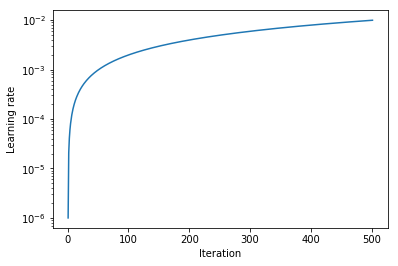

In [14]:
lr_finder.plot_lr()

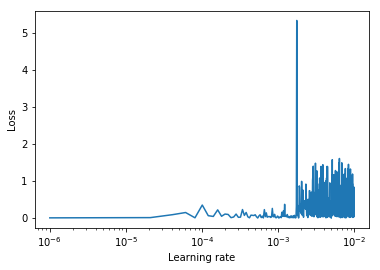

In [15]:
lr_finder.plot_loss()

In [13]:
# Conclusion: not much can be done to improve frozen network, just using learning rate. Try unfrozen.
myU = unetModel.getUnet('unfreeze4e.h5')
unetModel.unfreezeResnet(myU)
myU.compile(optimizer = Adam(lr = 1e-4), loss = weighted_cross_entropy(beta), 
            metrics = ['accuracy', weighted_cross_entropy(beta), keras.losses.binary_crossentropy, tversky_loss(tv_beta)])
myU.fit_generator( 
            train_gen,
            steps_per_epoch = steps_per_epoch,
            validation_data = valid_gen,
            validation_steps = validation_steps,
            epochs = epochs,
            callbacks=[lr_finder]
            )

/home/ubuntu/anaconda3/envs/tensorflow_p36/lib/python3.6/site-packages/keras_applications/resnet50.py:265: UserWarning: The output shape of `ResNet50(include_top=False)` has been changed since Keras 2.2.0.
  warnings.warn('The output shape of `ResNet50(include_top=False)` '


Epoch 1/3
167/167 [==============================] - 607s 4s/step - loss: 0.0557 - acc: 0.9916 - wce_loss: 0.0557 - binary_crossentropy: 0.0269 - tv_loss: 0.4500 - val_loss: 0.1376 - val_acc: 0.9897 - val_wce_loss: 0.1376 - val_binary_crossentropy: 0.0824 - val_tv_loss: 0.1265
Epoch 2/3
167/167 [==============================] - 585s 4s/step - loss: 0.0781 - acc: 0.9891 - wce_loss: 0.0781 - binary_crossentropy: 0.0366 - tv_loss: 0.2877 - val_loss: 0.3727 - val_acc: 0.9939 - val_wce_loss: 0.3727 - val_binary_crossentropy: 0.0934 - val_tv_loss: 0.0066
Epoch 3/3
167/167 [==============================] - 559s 3s/step - loss: 0.2402 - acc: 0.9888 - wce_loss: 0.2402 - binary_crossentropy: 0.0757 - tv_loss: 0.1126 - val_loss: 0.3337 - val_acc: 0.9945 - val_wce_loss: 0.3337 - val_binary_crossentropy: 0.0834 - val_tv_loss: 0.0000e+00


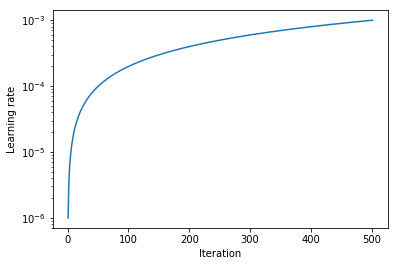

In [14]:
lr_finder.plot_lr()

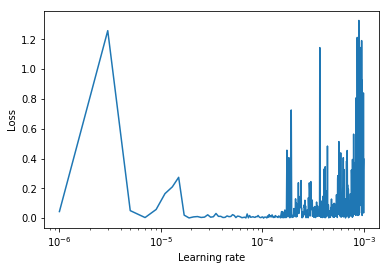

In [15]:
lr_finder.plot_loss()

In [16]:
epochs = 6
myU = unetModel.getUnet('unfreeze4e.h5')
unetModel.unfreezeResnet(myU)
myU.compile(optimizer = Adam(lr = 6e-6), loss = weighted_cross_entropy(beta), 
            metrics = ['accuracy', weighted_cross_entropy(beta), keras.losses.binary_crossentropy, tversky_loss(tv_beta)])
myU.fit_generator( 
            train_gen,
            steps_per_epoch = steps_per_epoch,
            validation_data = valid_gen,
            validation_steps = validation_steps,
            epochs = epochs,
            )

/home/ubuntu/anaconda3/envs/tensorflow_p36/lib/python3.6/site-packages/keras_applications/resnet50.py:265: UserWarning: The output shape of `ResNet50(include_top=False)` has been changed since Keras 2.2.0.
  warnings.warn('The output shape of `ResNet50(include_top=False)` '


Epoch 1/6
167/167 [==============================] - 590s 4s/step - loss: 0.0194 - acc: 0.9969 - wce_loss: 0.0194 - binary_crossentropy: 0.0090 - tv_loss: 0.5783 - val_loss: 0.0929 - val_acc: 0.9948 - val_wce_loss: 0.0929 - val_binary_crossentropy: 0.0286 - val_tv_loss: 0.3905
Epoch 2/6
167/167 [==============================] - 569s 3s/step - loss: 0.0093 - acc: 0.9973 - wce_loss: 0.0093 - binary_crossentropy: 0.0057 - tv_loss: 0.6130 - val_loss: 0.0363 - val_acc: 0.9957 - val_wce_loss: 0.0363 - val_binary_crossentropy: 0.0129 - val_tv_loss: 0.6218
Epoch 3/6
167/167 [==============================] - 568s 3s/step - loss: 0.0096 - acc: 0.9973 - wce_loss: 0.0096 - binary_crossentropy: 0.0058 - tv_loss: 0.6346 - val_loss: 0.0318 - val_acc: 0.9972 - val_wce_loss: 0.0318 - val_binary_crossentropy: 0.0099 - val_tv_loss: 0.5109
Epoch 4/6
167/167 [==============================] - 570s 3s/step - loss: 0.0092 - acc: 0.9972 - wce_loss: 0.0092 - binary_crossentropy: 0.0058 - tv_loss: 0.6494 - va

In [17]:
myU.save('unfreeze5.h5')

In [13]:
# Try Tversky loss for a few epochs.
unetModel.unfreezeResnet(myU)
epochs=3
myU.compile(optimizer = Adam(lr = 6e-6), loss = tversky_loss(tv_beta), 
            metrics = ['accuracy', weighted_cross_entropy(beta), keras.losses.binary_crossentropy, tversky_loss(tv_beta)])
myU.fit_generator( 
            train_gen,
            steps_per_epoch = steps_per_epoch,
            validation_data = valid_gen,
            validation_steps = validation_steps,
            epochs = epochs,
            )

Epoch 1/3
167/167 [==============================] - 609s 4s/step - loss: 0.0757 - acc: 0.5010 - wce_loss: 1.5053 - binary_crossentropy: 1.4978 - tv_loss: 0.0757 - val_loss: 0.0079 - val_acc: 0.0605 - val_wce_loss: 3.6650 - val_binary_crossentropy: 3.6649 - val_tv_loss: 0.0079
Epoch 2/3
167/167 [==============================] - 582s 3s/step - loss: 0.0086 - acc: 0.0184 - wce_loss: 4.5967 - binary_crossentropy: 4.5967 - tv_loss: 0.0086 - val_loss: 0.0074 - val_acc: 0.0074 - val_wce_loss: 5.7396 - val_binary_crossentropy: 5.7396 - val_tv_loss: 0.0074
Epoch 3/3
167/167 [==============================] - 565s 3s/step - loss: 0.0082 - acc: 0.0075 - wce_loss: 6.7099 - binary_crossentropy: 6.7099 - tv_loss: 0.0082 - val_loss: 0.0065 - val_acc: 0.0056 - val_wce_loss: 7.6458 - val_binary_crossentropy: 7.6458 - val_tv_loss: 0.0065


In [26]:
# Trying different tversky function, for a few epochs.
import focalTversky
myU = unetModel.getUnet('unfreeze5.h5')
unetModel.unfreezeResnet(myU)
myU.compile(optimizer = Adam(lr = 6e-6), loss = focalTversky.tversky_loss, 
            metrics = ['accuracy', weighted_cross_entropy(beta), keras.losses.binary_crossentropy, tversky_loss(tv_beta)])
myU.fit_generator( 
            train_gen,
            steps_per_epoch = steps_per_epoch,
            validation_data = valid_gen,
            validation_steps = validation_steps,
            epochs = epochs,
            )

/home/ubuntu/anaconda3/envs/tensorflow_p36/lib/python3.6/site-packages/keras_applications/resnet50.py:265: UserWarning: The output shape of `ResNet50(include_top=False)` has been changed since Keras 2.2.0.
  warnings.warn('The output shape of `ResNet50(include_top=False)` '


Epoch 1/3
167/167 [==============================] - 586s 4s/step - loss: 0.2200 - acc: 0.9972 - wce_loss: 0.0277 - binary_crossentropy: 0.0111 - tv_loss: 0.7089 - val_loss: 0.4989 - val_acc: 0.9957 - val_wce_loss: 0.1467 - val_binary_crossentropy: 0.0421 - val_tv_loss: 0.4939
Epoch 2/3
167/167 [==============================] - 562s 3s/step - loss: 0.1811 - acc: 0.9978 - wce_loss: 0.0155 - binary_crossentropy: 0.0085 - tv_loss: 0.7466 - val_loss: 0.3191 - val_acc: 0.9960 - val_wce_loss: 0.1397 - val_binary_crossentropy: 0.0385 - val_tv_loss: 0.7100
Epoch 3/3
167/167 [==============================] - 561s 3s/step - loss: 0.1636 - acc: 0.9978 - wce_loss: 0.0180 - binary_crossentropy: 0.0094 - tv_loss: 0.7643 - val_loss: 0.3582 - val_acc: 0.9974 - val_wce_loss: 0.0865 - val_binary_crossentropy: 0.0242 - val_tv_loss: 0.6312


In [31]:
myU.save('unfreeze5b.h5')

In [32]:
min_lr = 1e-6
max_lr = 1e-2
steps_per_epoch = 167
validation_steps = 41
epochs = 2
lr_finder = lr_find.LRFinder(min_lr=min_lr, max_lr=max_lr, steps_per_epoch=steps_per_epoch, epochs=epochs)
myU.fit_generator( 
            train_gen,
            steps_per_epoch = steps_per_epoch,
            validation_data = valid_gen,
            validation_steps = validation_steps,
            epochs = epochs,
            callbacks=[lr_finder]
            )

Epoch 1/2
167/167 [==============================] - 558s 3s/step - loss: 0.9534 - acc: 0.9929 - wce_loss: 0.4101 - binary_crossentropy: 0.1059 - tv_loss: 0.0410 - val_loss: 0.9984 - val_acc: 0.9951 - val_wce_loss: 0.2984 - val_binary_crossentropy: 0.0746 - val_tv_loss: 0.0000e+00
Epoch 2/2
167/167 [==============================] - 556s 3s/step - loss: 0.9992 - acc: 0.9935 - wce_loss: 0.3976 - binary_crossentropy: 0.0994 - tv_loss: 0.0000e+00 - val_loss: 0.9742 - val_acc: 0.9933 - val_wce_loss: 0.4090 - val_binary_crossentropy: 0.1023 - val_tv_loss: 0.0000e+00


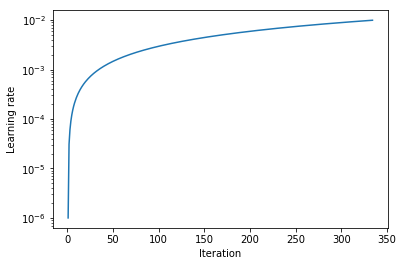

In [34]:
lr_finder.plot_lr()

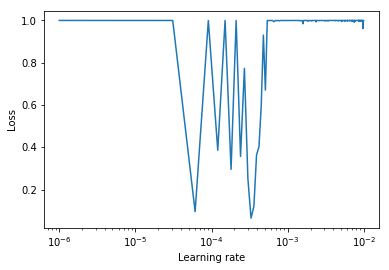

In [35]:
lr_finder.plot_loss()

In [13]:
# Trying different tversky function, for a few epochs, with found learning rate.
import focalTversky
myU = unetModel.getUnet('unfreeze5b.h5')
unetModel.unfreezeResnet(myU)
myU.compile(optimizer = Adam(lr = 6e-5), loss = focalTversky.tversky_loss, 
            metrics = ['accuracy', weighted_cross_entropy(beta), keras.losses.binary_crossentropy, tversky_loss(tv_beta)])
myU.fit_generator( 
            train_gen,
            steps_per_epoch = steps_per_epoch,
            validation_data = valid_gen,
            validation_steps = validation_steps,
            epochs = epochs,
            )

/home/ubuntu/anaconda3/envs/tensorflow_p36/lib/python3.6/site-packages/keras_applications/resnet50.py:265: UserWarning: The output shape of `ResNet50(include_top=False)` has been changed since Keras 2.2.0.
  warnings.warn('The output shape of `ResNet50(include_top=False)` '


Epoch 1/3
167/167 [==============================] - 607s 4s/step - loss: 0.2675 - acc: 0.9964 - wce_loss: 0.0747 - binary_crossentropy: 0.0311 - tv_loss: 0.6667 - val_loss: 0.5189 - val_acc: 0.9922 - val_wce_loss: 0.1823 - val_binary_crossentropy: 0.0857 - val_tv_loss: 0.4057
Epoch 2/3
167/167 [==============================] - 582s 3s/step - loss: 0.2747 - acc: 0.9962 - wce_loss: 0.0713 - binary_crossentropy: 0.0344 - tv_loss: 0.6607 - val_loss: 0.3142 - val_acc: 0.9964 - val_wce_loss: 0.1520 - val_binary_crossentropy: 0.0438 - val_tv_loss: 0.7109
Epoch 3/3
167/167 [==============================] - 561s 3s/step - loss: 0.2354 - acc: 0.9967 - wce_loss: 0.0624 - binary_crossentropy: 0.0310 - tv_loss: 0.6917 - val_loss: 0.4862 - val_acc: 0.9928 - val_wce_loss: 0.1241 - val_binary_crossentropy: 0.0769 - val_tv_loss: 0.4251


In [13]:
# Starting from model 5 (unfreeze5b.h5), unfrozen, try focal tversky.
epochs = 3
myU = unetModel.getUnet('unfreeze5b.h5')
unetModel.unfreezeResnet(myU)
myU.compile(optimizer = Adam(lr = 6e-5), loss = focalTversky.focal_tversky, 
            metrics = ['accuracy', weighted_cross_entropy(beta), keras.losses.binary_crossentropy, tversky_loss(tv_beta)])
myU.fit_generator( 
            train_gen,
            steps_per_epoch = steps_per_epoch,
            validation_data = valid_gen,
            validation_steps = validation_steps,
            epochs = epochs,
            )

/home/ubuntu/anaconda3/envs/tensorflow_p36/lib/python3.6/site-packages/keras_applications/resnet50.py:265: UserWarning: The output shape of `ResNet50(include_top=False)` has been changed since Keras 2.2.0.
  warnings.warn('The output shape of `ResNet50(include_top=False)` '


Epoch 1/3
167/167 [==============================] - 623s 4s/step - loss: 0.3647 - acc: 0.9959 - wce_loss: 0.0860 - binary_crossentropy: 0.0387 - tv_loss: 0.6579 - val_loss: 0.6203 - val_acc: 0.9893 - val_wce_loss: 0.2169 - val_binary_crossentropy: 0.1353 - val_tv_loss: 0.3290
Epoch 2/3
167/167 [==============================] - 593s 4s/step - loss: 0.3685 - acc: 0.9960 - wce_loss: 0.0950 - binary_crossentropy: 0.0427 - tv_loss: 0.6576 - val_loss: 0.4256 - val_acc: 0.9948 - val_wce_loss: 0.1325 - val_binary_crossentropy: 0.0639 - val_tv_loss: 0.6491
Epoch 3/3
167/167 [==============================] - 571s 3s/step - loss: 0.3568 - acc: 0.9966 - wce_loss: 0.0942 - binary_crossentropy: 0.0386 - tv_loss: 0.6945 - val_loss: 0.4577 - val_acc: 0.9970 - val_wce_loss: 0.0917 - val_binary_crossentropy: 0.0341 - val_tv_loss: 0.6081


In [14]:
myU.save('unfreeze5c.h5')

In [15]:
min_lr = 1e-6
max_lr = 1e-2
steps_per_epoch = 167
validation_steps = 41
epochs = 2
lr_finder = lr_find.LRFinder(min_lr=min_lr, max_lr=max_lr, steps_per_epoch=steps_per_epoch, epochs=epochs)
myU.fit_generator( 
            train_gen,
            steps_per_epoch = steps_per_epoch,
            validation_data = valid_gen,
            validation_steps = validation_steps,
            epochs = epochs,
            callbacks=[lr_finder]
            )

Epoch 1/2
167/167 [==============================] - 567s 3s/step - loss: 0.9105 - acc: 0.9916 - wce_loss: 0.3886 - binary_crossentropy: 0.1136 - tv_loss: 0.0942 - val_loss: 0.9970 - val_acc: 0.9943 - val_wce_loss: 0.3481 - val_binary_crossentropy: 0.0870 - val_tv_loss: 0.0000e+00
Epoch 2/2
167/167 [==============================] - 568s 3s/step - loss: 0.9994 - acc: 0.9932 - wce_loss: 0.4188 - binary_crossentropy: 0.1047 - tv_loss: 0.0000e+00 - val_loss: 0.9994 - val_acc: 0.9927 - val_wce_loss: 0.4487 - val_binary_crossentropy: 0.1122 - val_tv_loss: 0.0000e+00


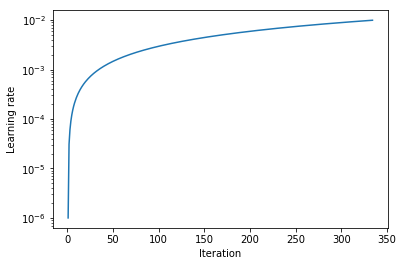

In [16]:
lr_finder.plot_lr()

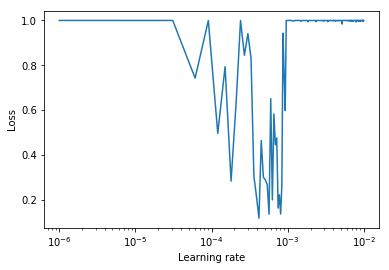

In [17]:
lr_finder.plot_loss()

In [15]:
# Try found lr
epochs = 3
myU = unetModel.getUnet('unfreeze5c.h5')
unetModel.unfreezeResnet(myU)
myU.compile(optimizer = Adam(lr = 3e-4), loss = focalTversky.focal_tversky, 
            metrics = ['accuracy', weighted_cross_entropy(beta), keras.losses.binary_crossentropy, tversky_loss(tv_beta)])
myU.fit_generator( 
            train_gen,
            steps_per_epoch = steps_per_epoch,
            validation_data = valid_gen,
            validation_steps = validation_steps,
            epochs = epochs,
            )

/home/ubuntu/anaconda3/envs/tensorflow_p36/lib/python3.6/site-packages/keras_applications/resnet50.py:265: UserWarning: The output shape of `ResNet50(include_top=False)` has been changed since Keras 2.2.0.
  warnings.warn('The output shape of `ResNet50(include_top=False)` '


Epoch 1/3
167/167 [==============================] - 616s 4s/step - loss: 0.5004 - acc: 0.9928 - wce_loss: 0.1949 - binary_crossentropy: 0.0962 - tv_loss: 0.5360 - val_loss: 0.8135 - val_acc: 0.9764 - val_wce_loss: 0.4989 - val_binary_crossentropy: 0.3350 - val_tv_loss: 0.2460
Epoch 2/3
167/167 [==============================] - 587s 4s/step - loss: 0.4896 - acc: 0.9928 - wce_loss: 0.1840 - binary_crossentropy: 0.0977 - tv_loss: 0.5446 - val_loss: 0.7592 - val_acc: 0.9408 - val_wce_loss: 1.0208 - val_binary_crossentropy: 0.8988 - val_tv_loss: 0.3108
Epoch 3/3
167/167 [==============================] - 565s 3s/step - loss: 0.4638 - acc: 0.9934 - wce_loss: 0.1778 - binary_crossentropy: 0.0924 - tv_loss: 0.5570 - val_loss: 0.6947 - val_acc: 0.9761 - val_wce_loss: 0.4424 - val_binary_crossentropy: 0.3601 - val_tv_loss: 0.2847


In [12]:
myU.fit_generator( 
            train_gen,
            steps_per_epoch = 167,
            validation_data = valid_gen,
            validation_steps = 41,
            epochs = 6
            )

Epoch 1/6
167/167 [==============================] - 728s 4s/step - loss: 0.0593 - acc: 0.9918 - wce_loss: 0.0593 - binary_crossentropy: 0.0287 - tv_loss: 0.3485 - val_loss: 0.0736 - val_acc: 0.9941 - val_wce_loss: 0.0736 - val_binary_crossentropy: 0.0245 - val_tv_loss: 0.2994
Epoch 2/6
167/167 [==============================] - 699s 4s/step - loss: 0.0311 - acc: 0.9935 - wce_loss: 0.0311 - binary_crossentropy: 0.0172 - tv_loss: 0.4352 - val_loss: 0.0340 - val_acc: 0.9960 - val_wce_loss: 0.0340 - val_binary_crossentropy: 0.0126 - val_tv_loss: 0.3744
Epoch 3/6
167/167 [==============================] - 686s 4s/step - loss: 0.0265 - acc: 0.9943 - wce_loss: 0.0265 - binary_crossentropy: 0.0150 - tv_loss: 0.4603 - val_loss: 0.0515 - val_acc: 0.9960 - val_wce_loss: 0.0515 - val_binary_crossentropy: 0.0146 - val_tv_loss: 0.5196
Epoch 4/6
167/167 [==============================] - 683s 4s/step - loss: 0.0268 - acc: 0.9942 - wce_loss: 0.0268 - binary_crossentropy: 0.0151 - tv_loss: 0.4938 - va

In [14]:
myU.save('freeze4b.h5')

In [27]:
myU.fit_generator( 
            train_gen,
            steps_per_epoch = 167,
            validation_data = valid_gen,
            validation_steps = 41,
            epochs = 3
            )

Epoch 1/3
167/167 [==============================] - 683s 4s/step - loss: 0.0406 - acc: 0.9936 - wce_loss: 0.0406 - binary_crossentropy: 0.0209 - tv_loss: 0.4309 - val_loss: 0.0681 - val_acc: 0.9949 - val_wce_loss: 0.0681 - val_binary_crossentropy: 0.0226 - val_tv_loss: 0.3617
Epoch 2/3
167/167 [==============================] - 686s 4s/step - loss: 0.0201 - acc: 0.9953 - wce_loss: 0.0201 - binary_crossentropy: 0.0115 - tv_loss: 0.5072 - val_loss: 0.0518 - val_acc: 0.9958 - val_wce_loss: 0.0518 - val_binary_crossentropy: 0.0159 - val_tv_loss: 0.5102
Epoch 3/3
167/167 [==============================] - 685s 4s/step - loss: 0.0210 - acc: 0.9951 - wce_loss: 0.0210 - binary_crossentropy: 0.0120 - tv_loss: 0.5305 - val_loss: 0.0359 - val_acc: 0.9963 - val_wce_loss: 0.0359 - val_binary_crossentropy: 0.0118 - val_tv_loss: 0.4944


In [32]:
myU.save('freeze4c.h5')

In [11]:
unetModel.unfreezeResnet(myU)

In [16]:
for layer in myU.layers:
    print( layer.trainable)

False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
Fals

In [12]:
myU.compile(optimizer = Adam(lr = 1e-5), loss = weighted_cross_entropy(beta), 
            metrics = ['accuracy', weighted_cross_entropy(beta), keras.losses.binary_crossentropy, tversky_loss(tv_beta)])


In [13]:
# Unfroze resnet50, reduced learning rate, see where training goes.
myU.fit_generator( 
            train_gen,
            steps_per_epoch = 250,
            validation_data = valid_gen,
            validation_steps = 62,
            epochs = 3
            )

Epoch 1/3
250/250 [==============================] - 917s 4s/step - loss: 0.0195 - acc: 0.9957 - wce_loss: 0.0195 - binary_crossentropy: 0.0108 - tv_loss: 0.4983 - val_loss: 0.0394 - val_acc: 0.9959 - val_wce_loss: 0.0394 - val_binary_crossentropy: 0.0129 - val_tv_loss: 0.4329
Epoch 2/3
250/250 [==============================] - 893s 4s/step - loss: 0.0154 - acc: 0.9962 - wce_loss: 0.0154 - binary_crossentropy: 0.0090 - tv_loss: 0.5287 - val_loss: 0.0274 - val_acc: 0.9966 - val_wce_loss: 0.0274 - val_binary_crossentropy: 0.0097 - val_tv_loss: 0.4746
Epoch 3/3
250/250 [==============================] - 870s 3s/step - loss: 0.0145 - acc: 0.9964 - wce_loss: 0.0145 - binary_crossentropy: 0.0084 - tv_loss: 0.5411 - val_loss: 0.0296 - val_acc: 0.9960 - val_wce_loss: 0.0296 - val_binary_crossentropy: 0.0119 - val_tv_loss: 0.4436


In [22]:
myU.save('unfreeze4d.h5')

In [29]:
myU.fit_generator( 
            train_gen,
            steps_per_epoch = 250,
            validation_data = valid_gen,
            validation_steps = 62,
            epochs = 6
            )

Epoch 1/6
250/250 [==============================] - 867s 3s/step - loss: 0.0206 - acc: 0.9963 - wce_loss: 0.0206 - binary_crossentropy: 0.0109 - tv_loss: 0.4911 - val_loss: 0.0476 - val_acc: 0.9946 - val_wce_loss: 0.0476 - val_binary_crossentropy: 0.0188 - val_tv_loss: 0.3872
Epoch 2/6
250/250 [==============================] - 870s 3s/step - loss: 0.0142 - acc: 0.9966 - wce_loss: 0.0142 - binary_crossentropy: 0.0082 - tv_loss: 0.5593 - val_loss: 0.0184 - val_acc: 0.9958 - val_wce_loss: 0.0184 - val_binary_crossentropy: 0.0107 - val_tv_loss: 0.4554
Epoch 3/6
250/250 [==============================] - 870s 3s/step - loss: 0.0126 - acc: 0.9967 - wce_loss: 0.0126 - binary_crossentropy: 0.0075 - tv_loss: 0.5673 - val_loss: 0.0306 - val_acc: 0.9949 - val_wce_loss: 0.0306 - val_binary_crossentropy: 0.0138 - val_tv_loss: 0.4891
Epoch 4/6
250/250 [==============================] - 869s 3s/step - loss: 0.0124 - acc: 0.9968 - wce_loss: 0.0124 - binary_crossentropy: 0.0074 - tv_loss: 0.5757 - va

In [40]:
myU.save('unfreeze4e.h5')

In [16]:
from keras.preprocessing import image
from keras.preprocessing.image import ImageDataGenerator


In [17]:
test_dir = '/home/ubuntu/notebooks/shipid/data/test/images'
test_datagen = ImageDataGenerator()

In [18]:
test_generator = test_datagen.flow_from_directory(test_dir, target_size=(768,768), batch_size=1, class_mode=None)

Found 215 images belonging to 1 classes.


In [20]:
y_pred1 = myU.predict_generator(test_generator, verbose=1, steps=10)

10/10 [==============================] - 18s 2s/step


In [21]:
mask_dir = '/home/ubuntu/notebooks/shipid/data/bigboats/masks'
#mk = mpimg.imread(os.path.join(mask_dir,fn))

In [18]:
reload(generators)

<module 'generators' from '/home/ubuntu/notebooks/shipid/kerasUnet/generators.py'>

In [19]:
test_gen = generators.getTestGenerator(testImgDir, testMaskDir, img_size, batchSize)


Found 215 images belonging to 1 classes.
Found 215 images belonging to 1 classes.


In [20]:
# Need 107 steps after unfreezing, as batch size was reduced to 2
myU.evaluate_generator(test_gen, steps=107, verbose=1)
#myU.evaluate_generator(test_gen, steps=71, verbose=1)

107/107 [==============================] - 119s 1s/step


[0.6710233288669141,
 0.9709468077276354,
 0.506046994284631,
 0.423360651543921,
 0.32383354622096727]

In [29]:
myU.metrics_names

['loss', 'acc', 'wce_loss', 'binary_crossentropy', 'tv_loss']

In [21]:
#import displayPredVsTarget
import disp2

In [22]:
reload(disp2)

<module 'disp2' from '/home/ubuntu/notebooks/shipid/kerasUnet/disp2.py'>

In [22]:
predBase_dir = '/home/ubuntu/notebooks/shipid'
predImage_dir = os.path.join(predBase_dir, 'data/test/images/boats')
target_dir = os.path.join(predBase_dir, 'data/test/masks/boats')


In [23]:
srcFile = os.path.join(predBase_dir, 'kerasUnet/testDisplayList.txt')
fileList = []
for line in open(srcFile):
    fileList.append(line.rstrip())
fileList


['4dc952993.jpg',
 '4e3a19cf2.jpg',
 '4e4abce24.jpg',
 '4ec28a308.jpg',
 '4ec819543.jpg',
 '4f7d0e2fb.jpg',
 '4ff279eeb.jpg',
 '5e863d86e.jpg',
 '5eeaf898d.jpg',
 '6ca571ccc.jpg',
 '6d3edce0d.jpg',
 '6d41fbbbd.jpg',
 '6ef274463.jpg',
 '7bde5fb68.jpg',
 '7de65a67a.jpg',
 '8c2e17776.jpg',
 '8e9f64ef7.jpg',
 '8e27ba608.jpg',
 '9b94a756d.jpg',
 '9cb78f9e6.jpg',
 '53d7d0fc0.jpg',
 '97d3f5067.jpg',
 '986c21d85.jpg',
 '9664b3648.jpg',
 '95940e5b9.jpg',
 '840421592.jpg',
 'ad8e85621.jpg',
 'bef2e129f.jpg',
 'ca6102e69.jpg',
 'd30187b5a.jpg',
 'e4b08db5c.jpg',
 'e7b0bc853.jpg',
 'edb2f89f0.jpg',
 '']

In [24]:
# Create predicted mask for each filename in given list, so can display original image,
# target mask and predicted mask side by side.
imgData = []
for filename in fileList:
    if len(filename) > 0:
        imgFile = os.path.join(predImage_dir, filename)
        imgData.append(plt.imread(imgFile))
predMasks = myU.predict(np.array(imgData), batch_size=3, verbose=1)

33/33 [==============================] - 36s 1s/step


In [43]:
predMasks.shape

(33, 768, 768, 1)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


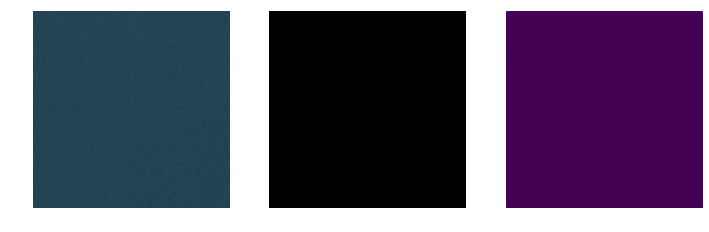

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


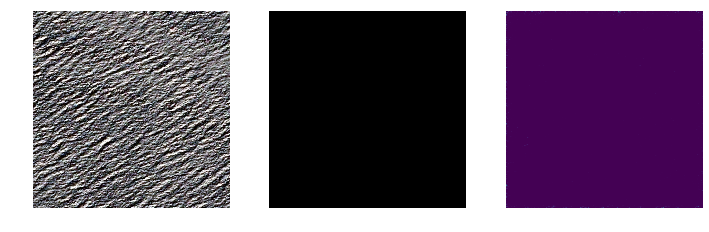

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


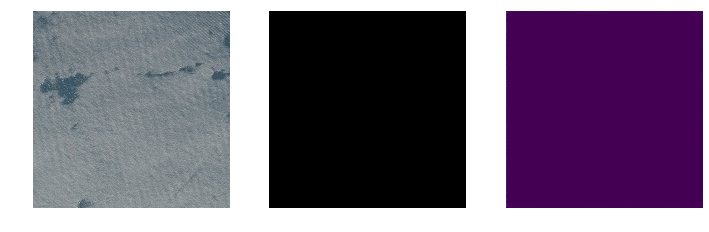

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


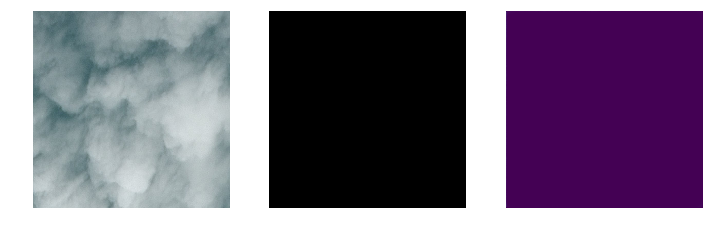

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


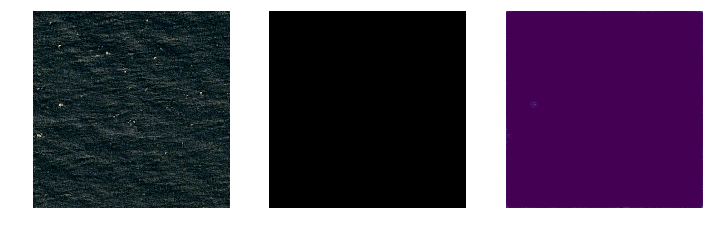

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


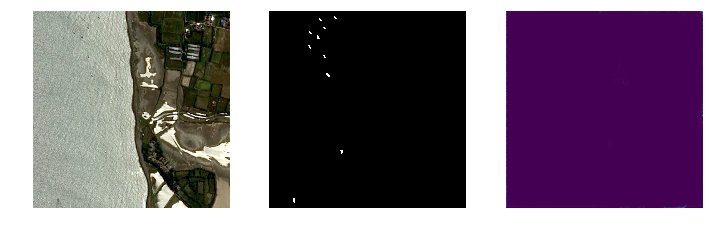

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


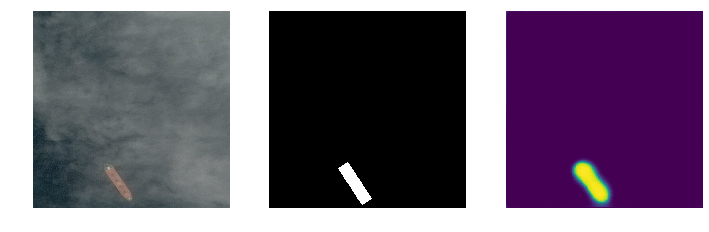

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


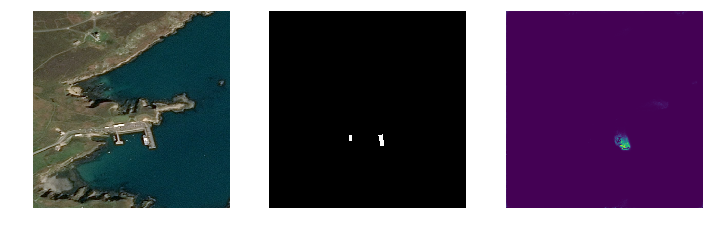

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


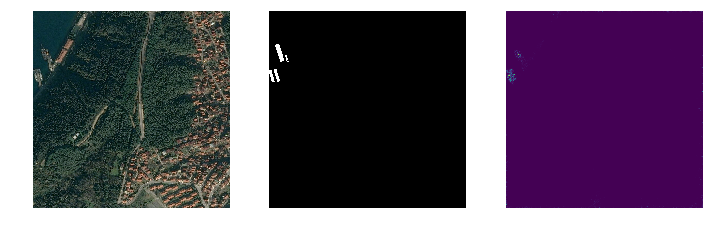

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


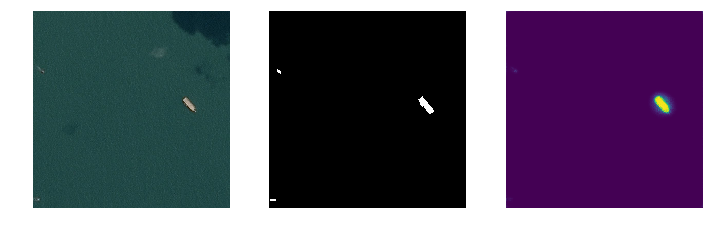

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


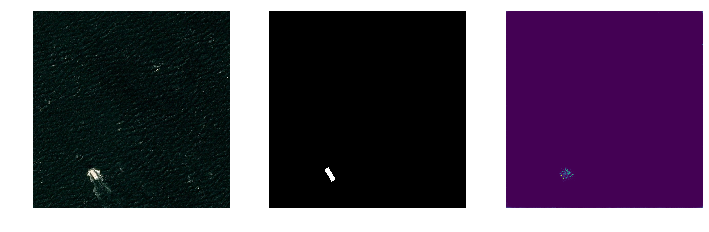

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


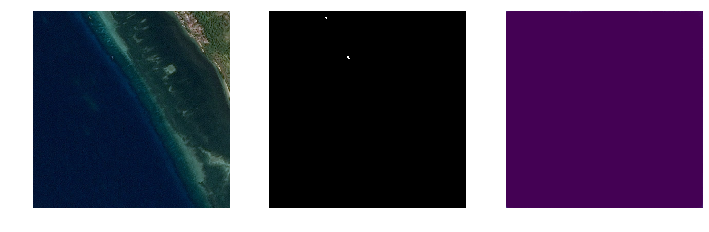

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


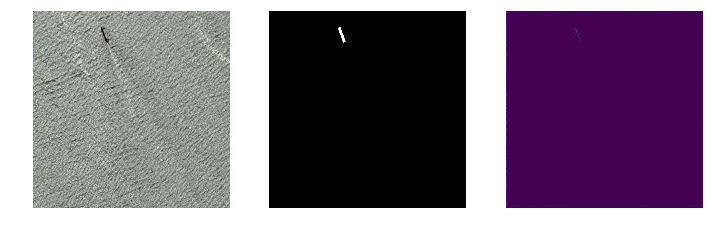

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


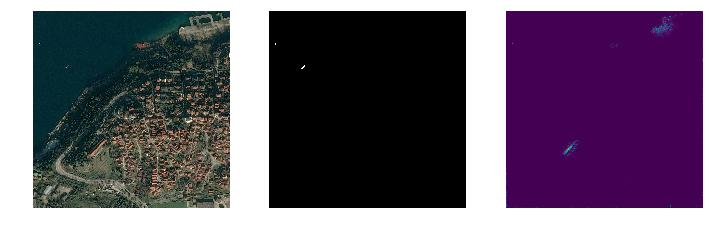

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


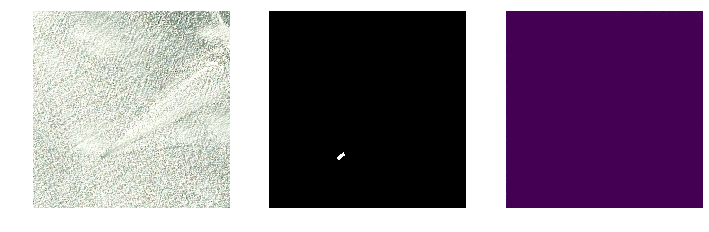

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


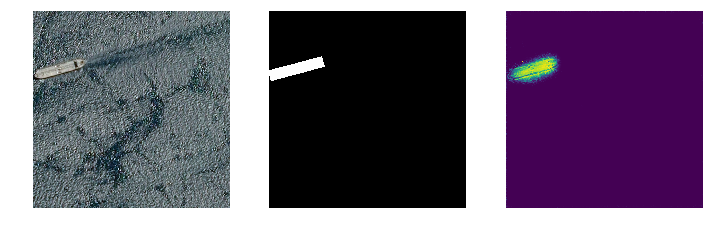

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


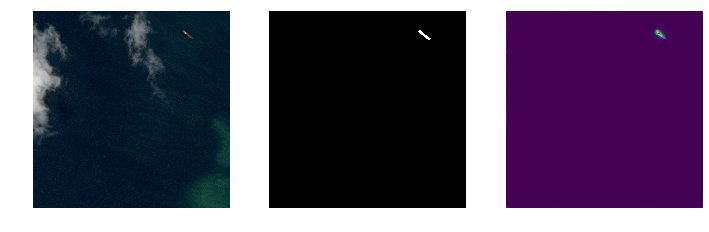

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


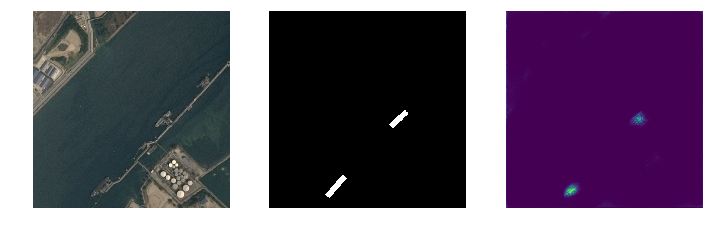

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


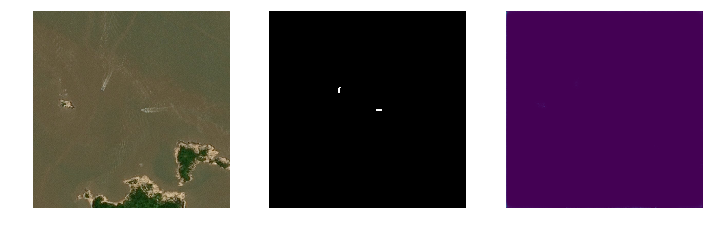

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


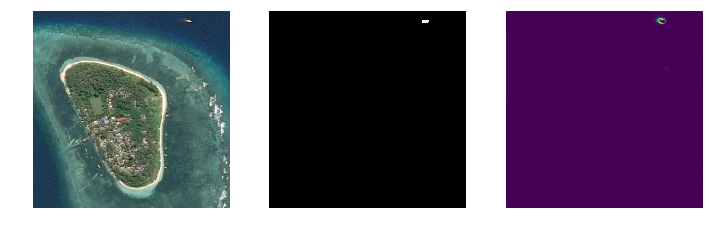

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


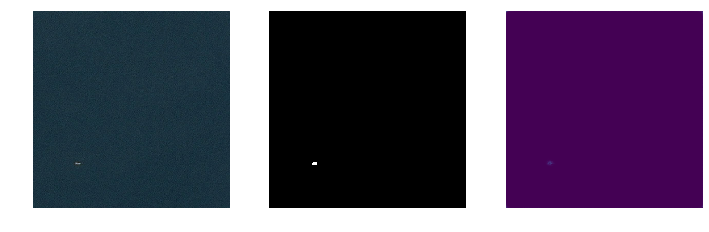

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


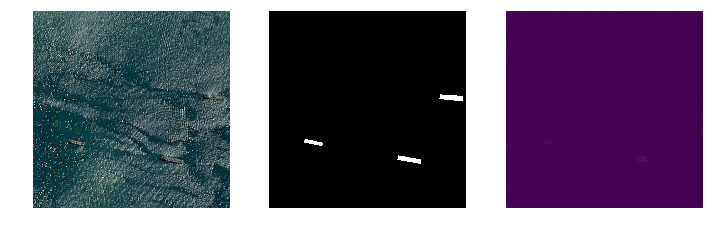

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


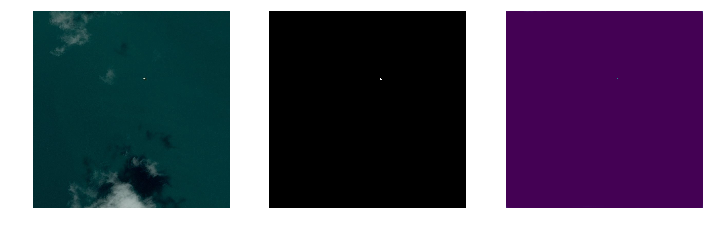

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


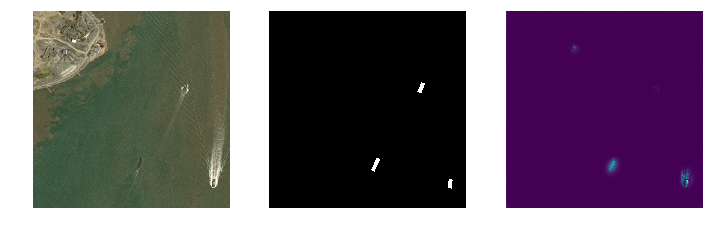

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


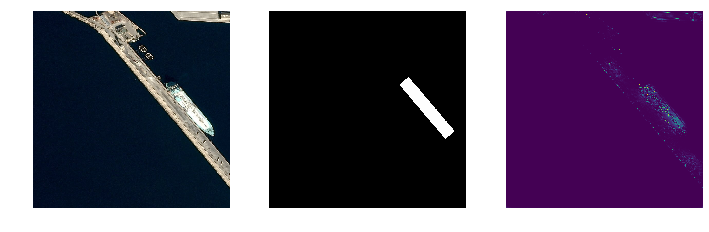

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


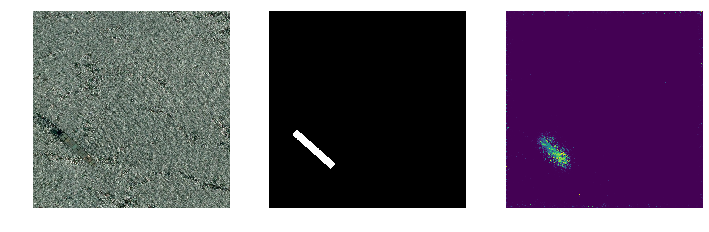

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


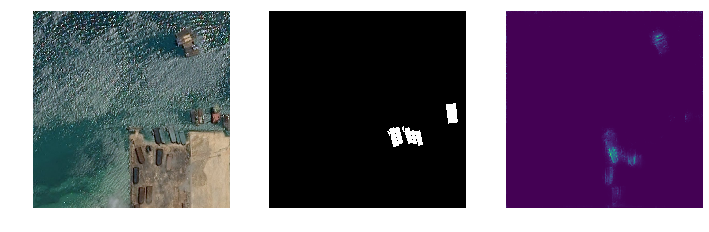

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


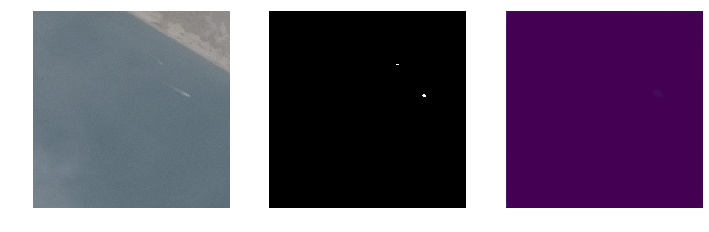

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


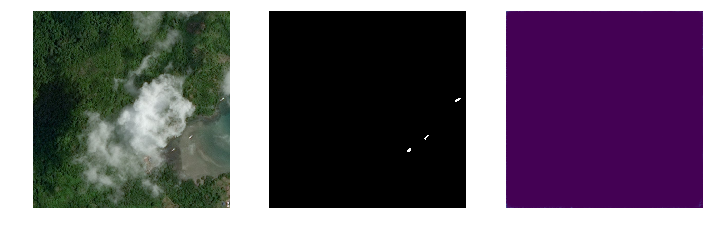

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


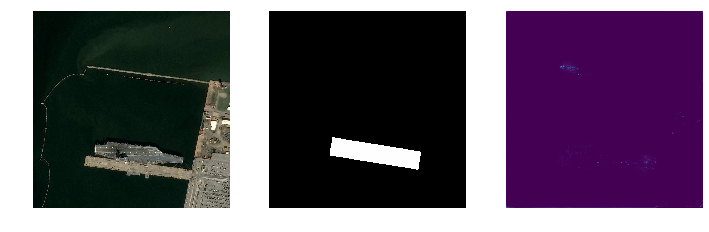

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


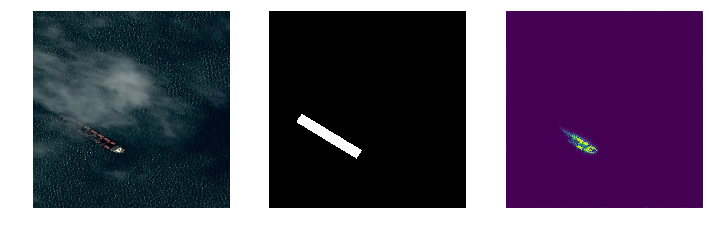

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


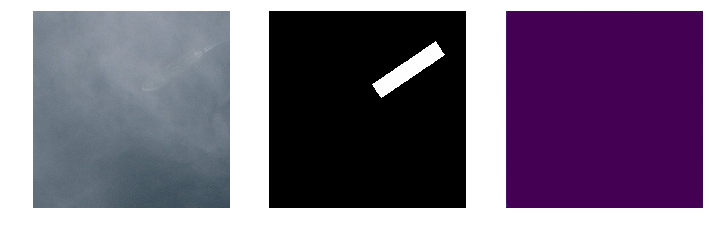

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


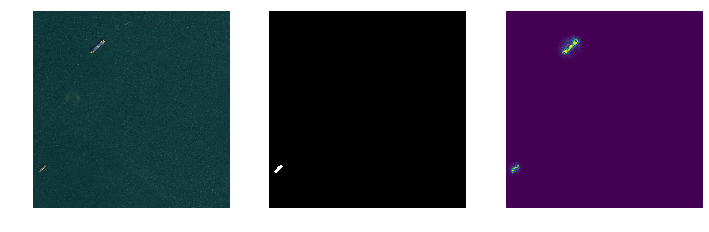

In [46]:
disp2.displayFiles(fileList, predImage_dir, target_dir, predMasks)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


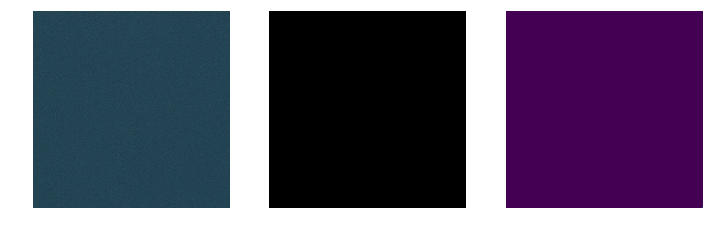

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


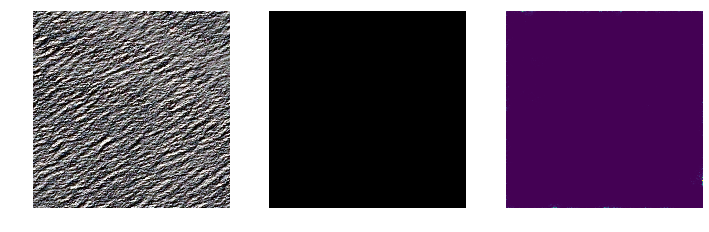

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


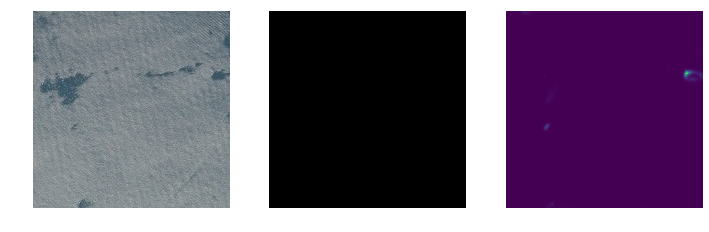

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


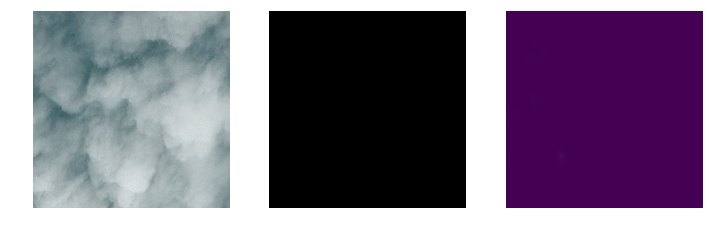

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


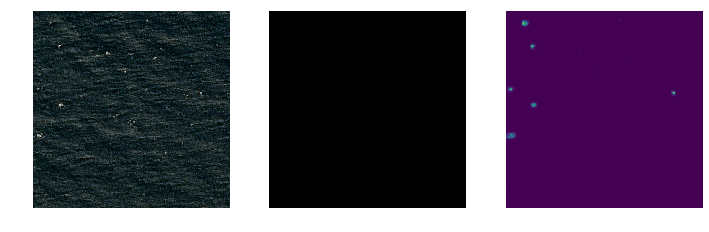

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


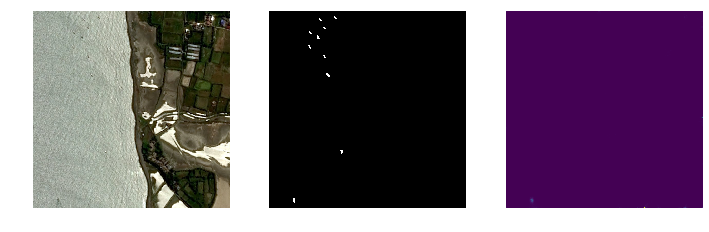

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


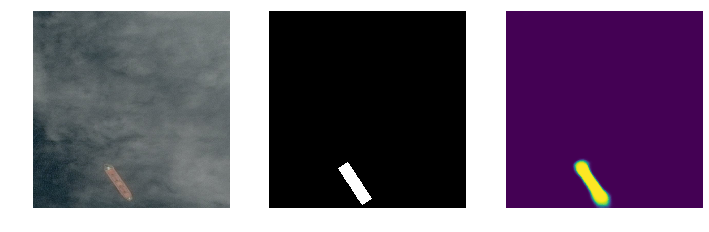

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


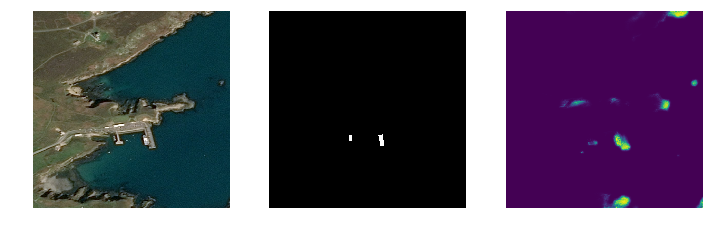

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


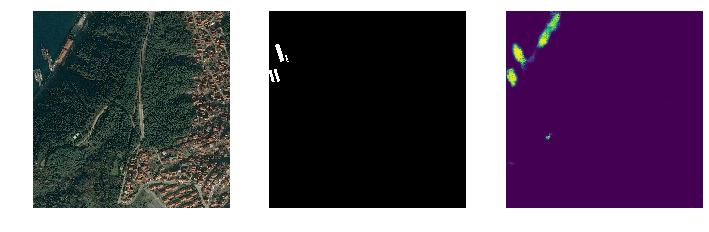

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


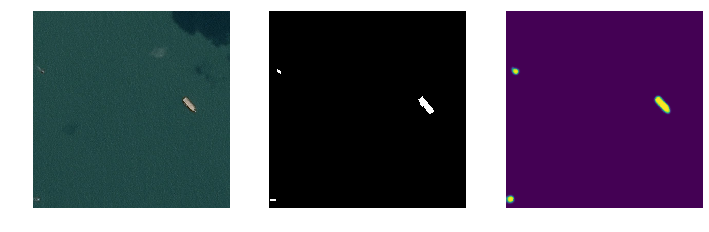

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


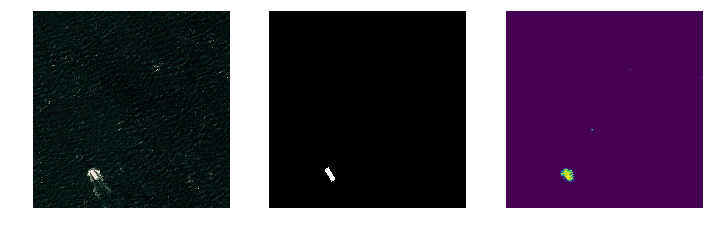

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


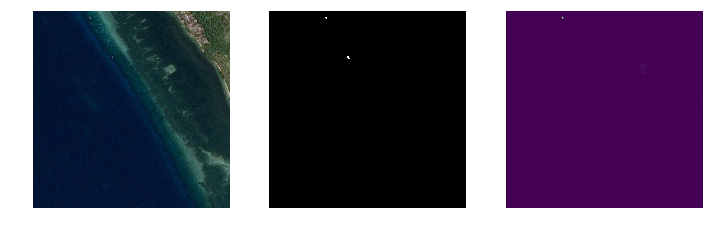

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


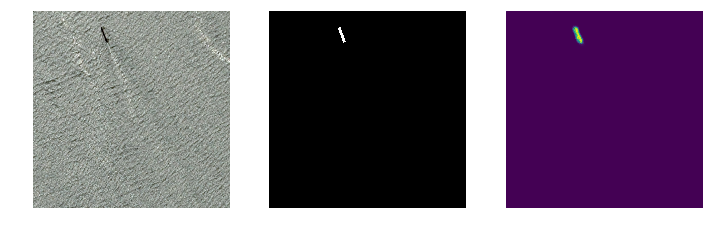

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


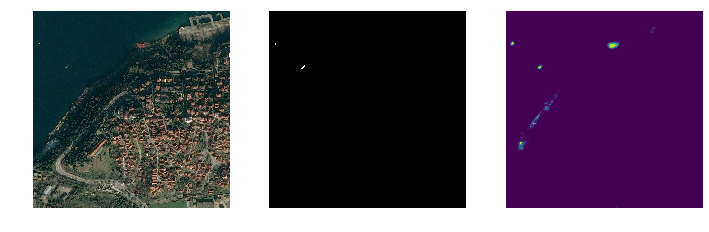

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


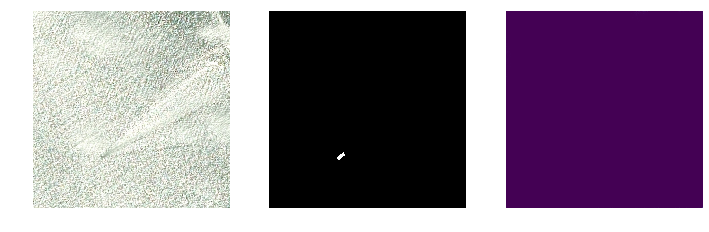

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


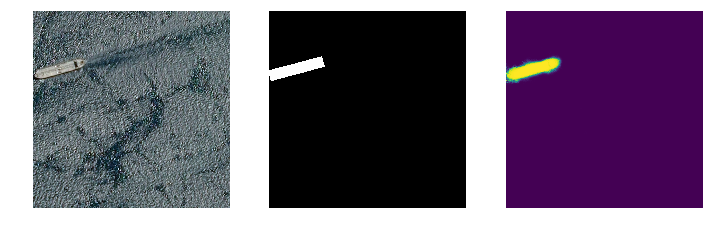

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


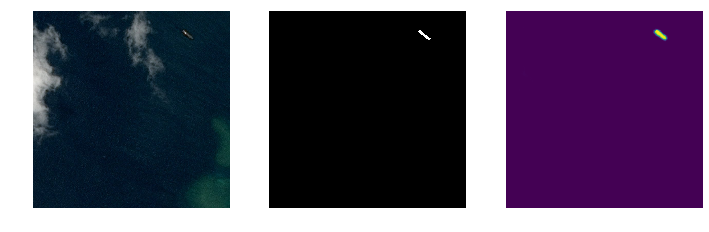

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


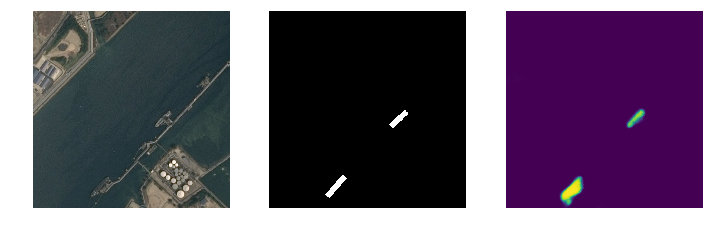

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


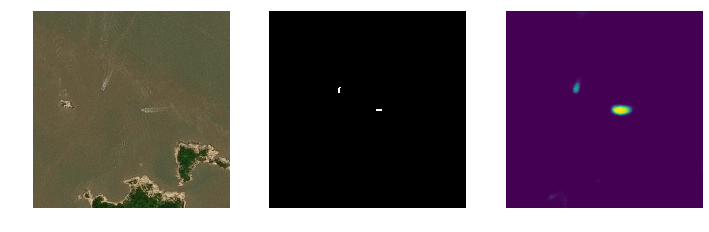

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


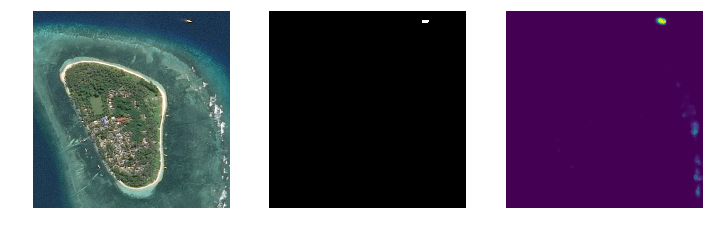

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


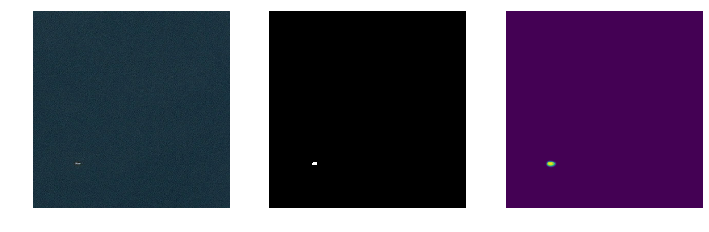

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


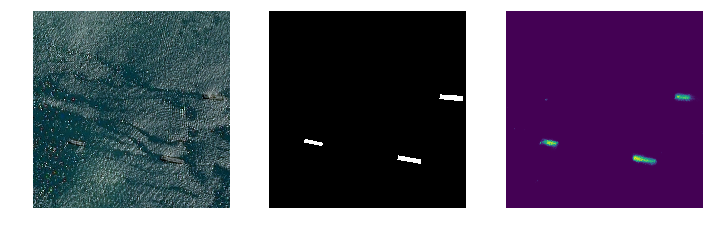

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


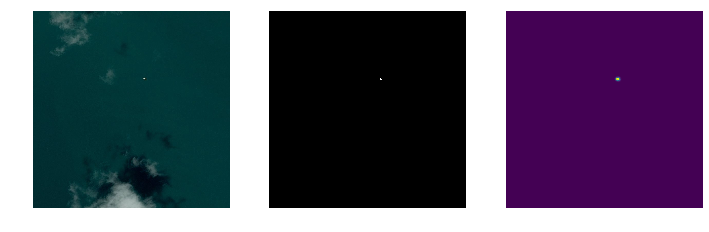

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


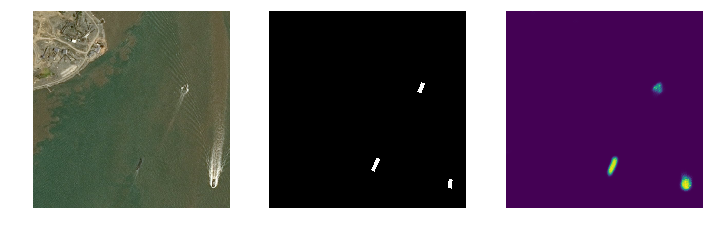

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


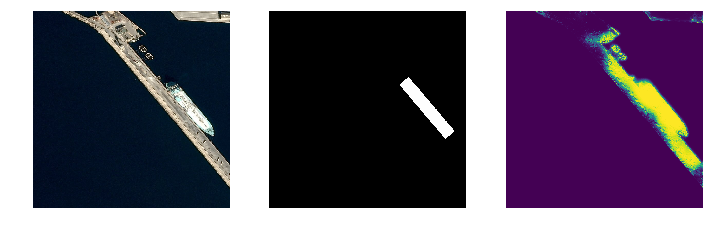

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


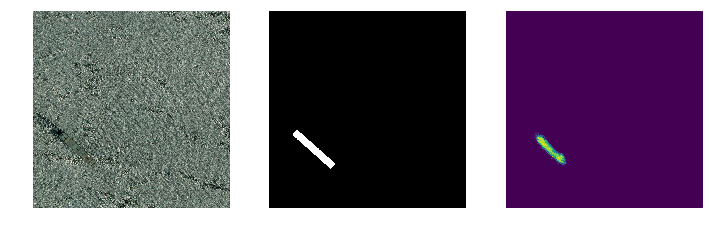

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


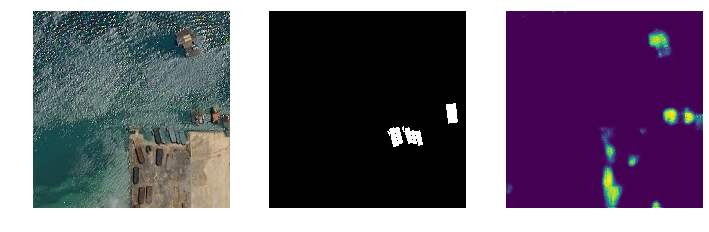

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


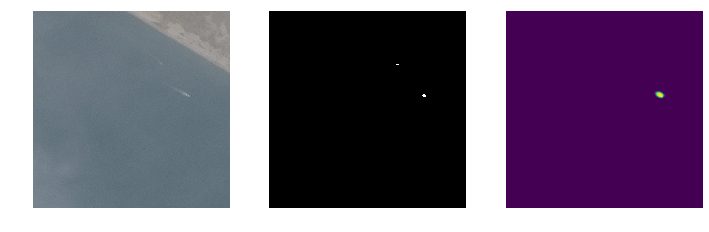

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


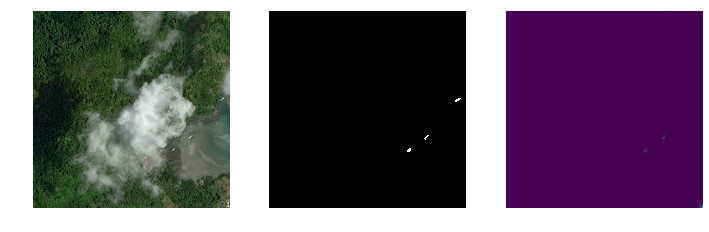

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


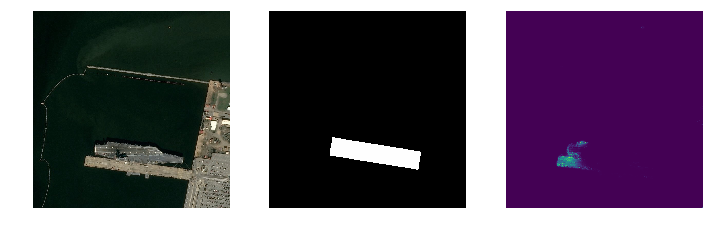

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


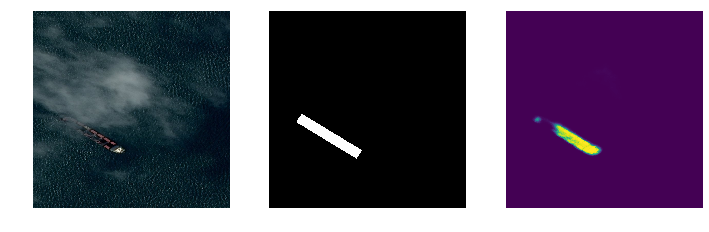

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


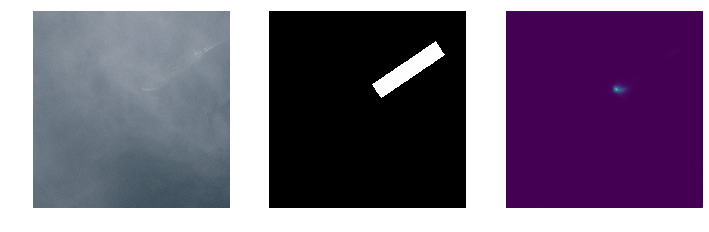

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


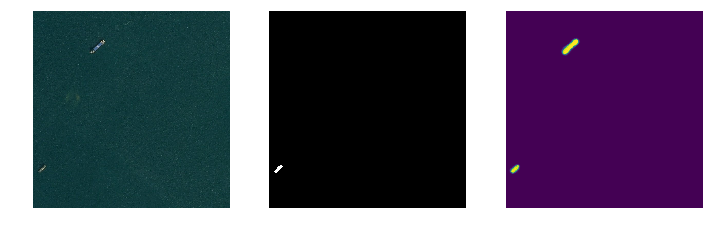

In [28]:
disp2.displayFiles(fileList, predImage_dir, target_dir, predMasks)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


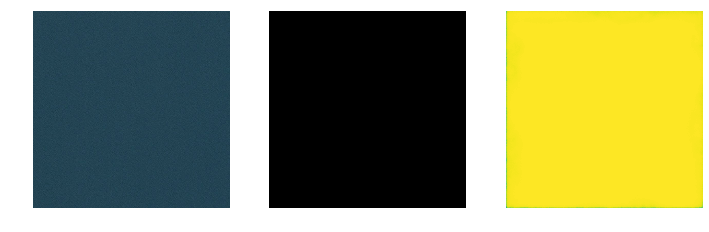

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


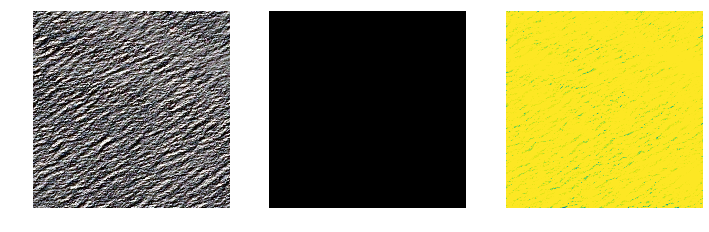

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


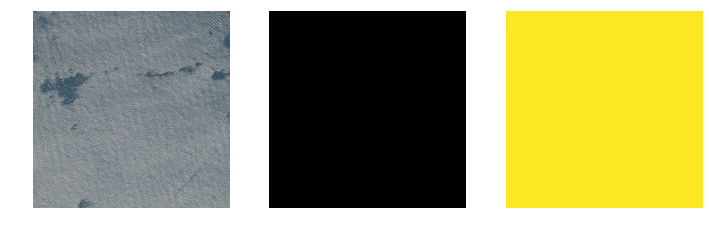

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


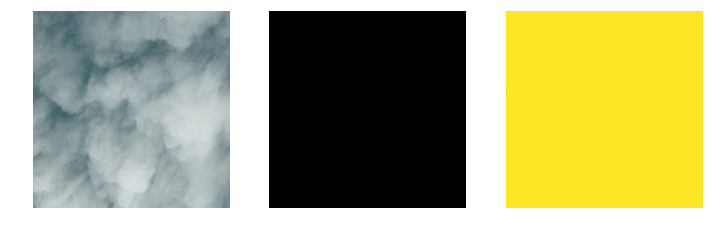

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


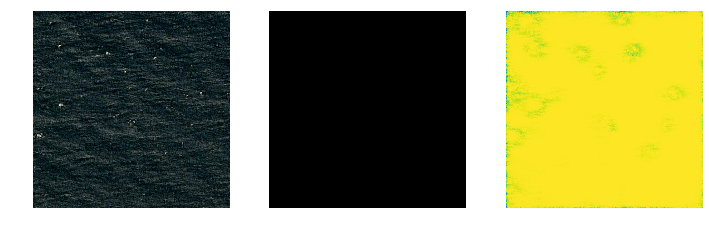

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


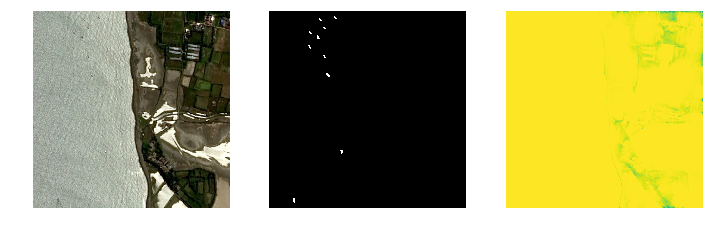

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


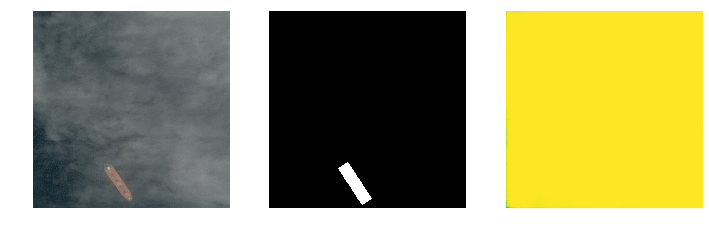

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


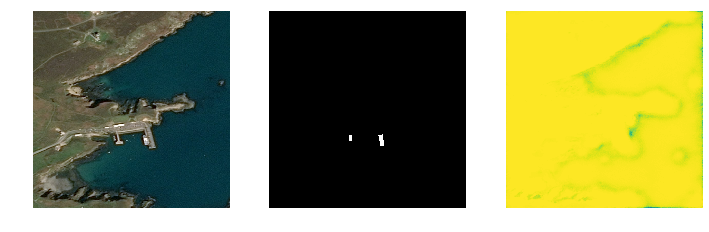

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


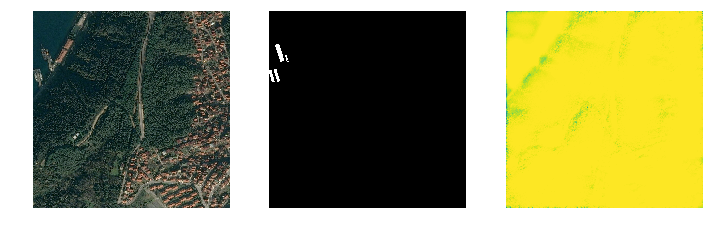

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


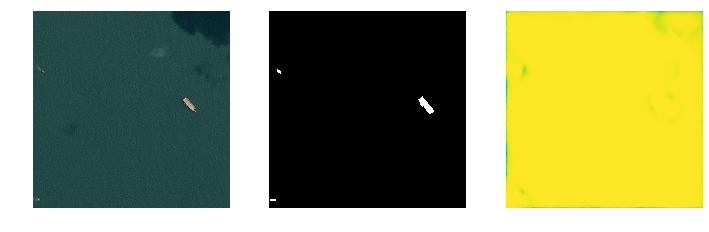

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


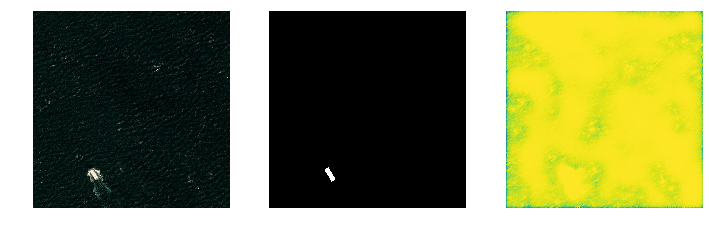

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


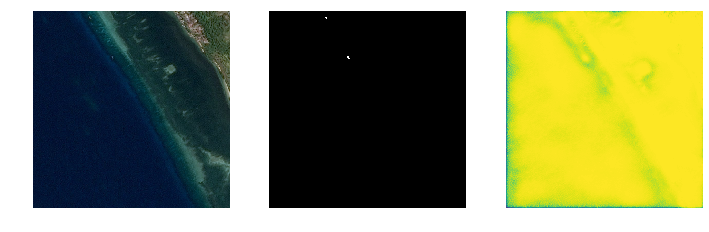

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


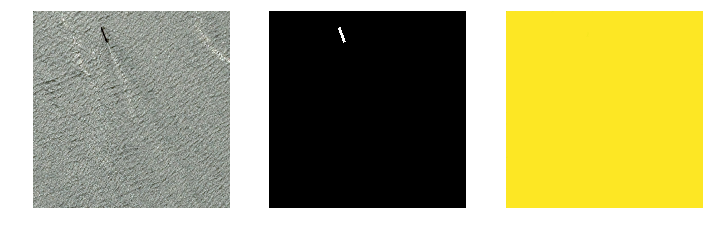

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


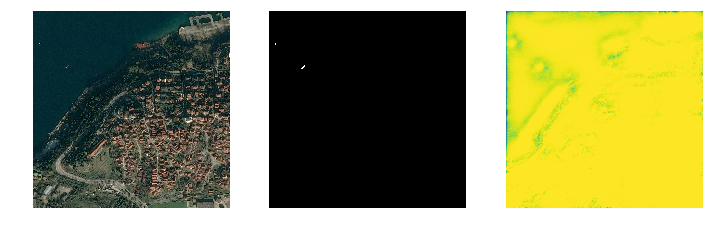

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


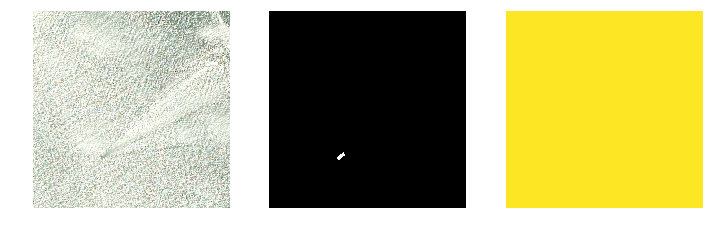

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


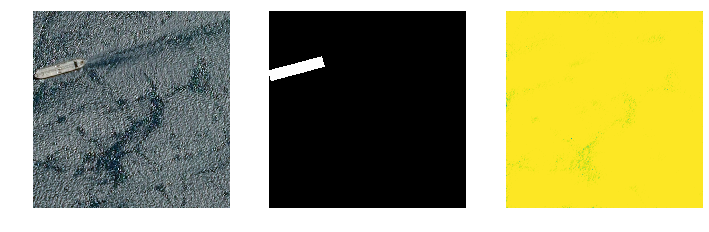

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


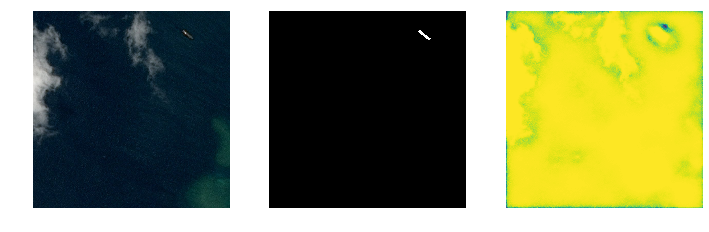

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


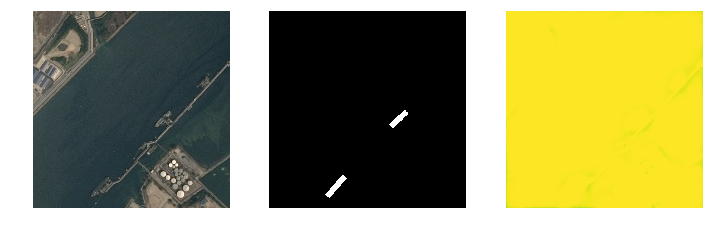

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


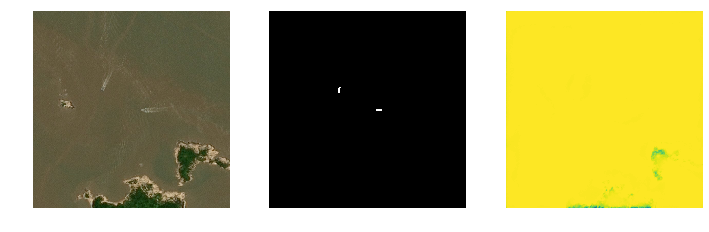

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


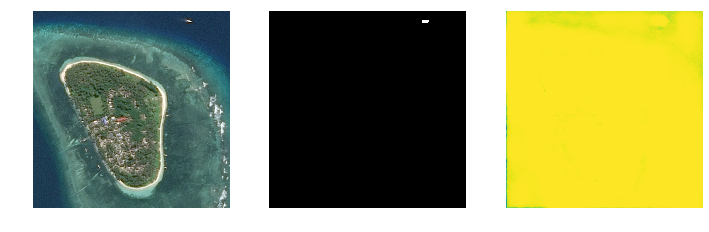

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


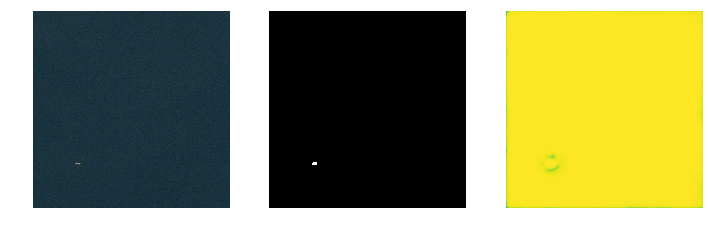

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


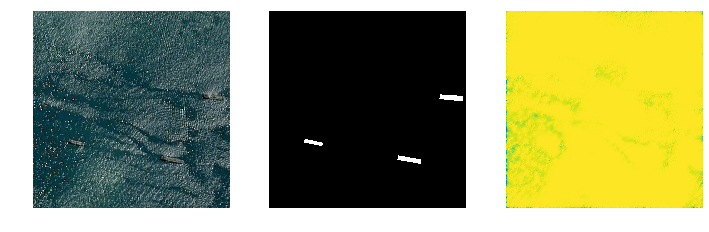

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


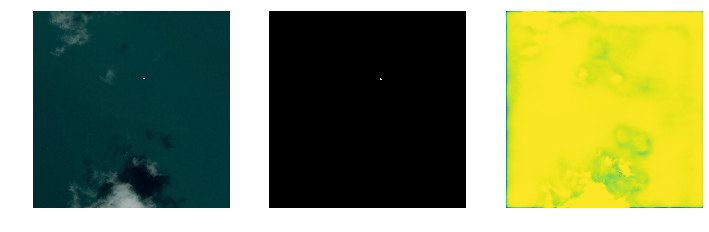

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


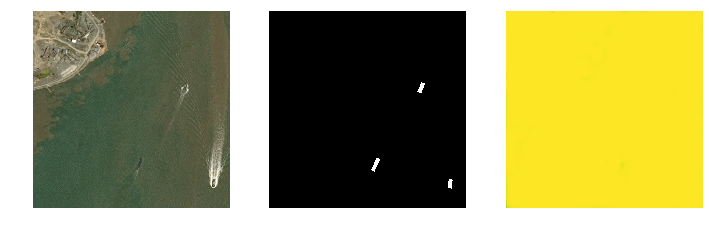

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


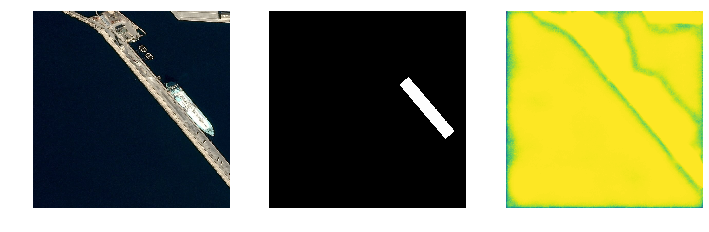

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


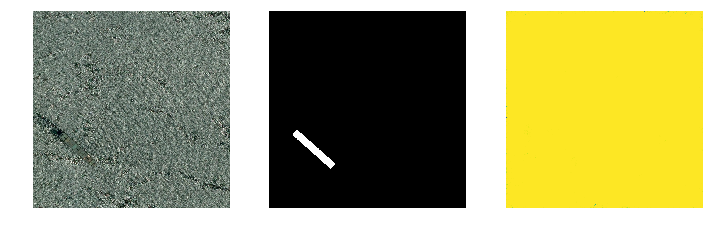

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


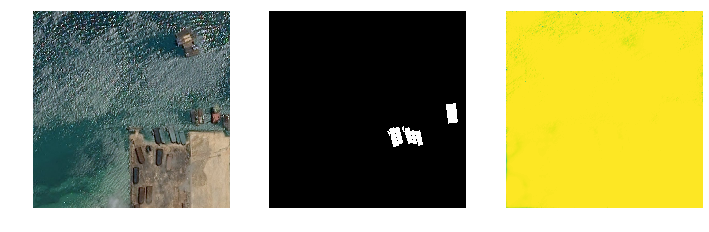

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


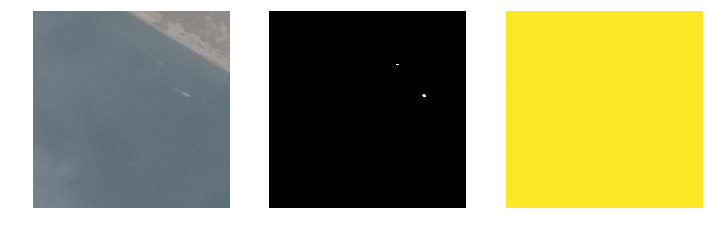

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


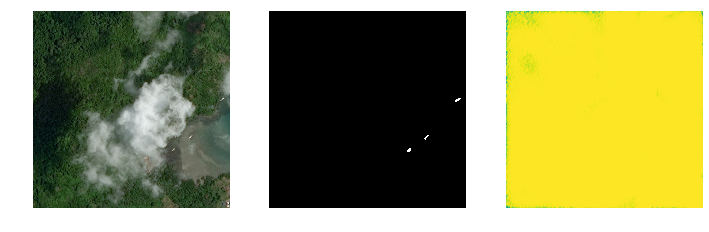

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


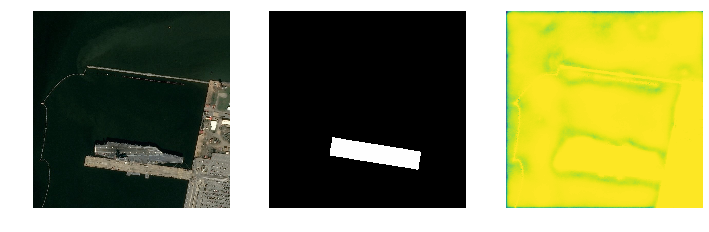

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


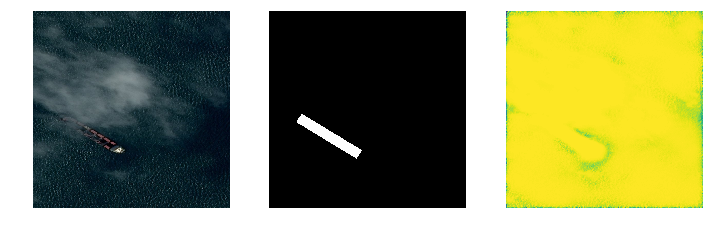

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


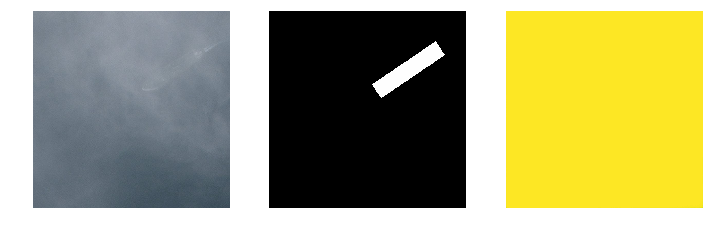

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


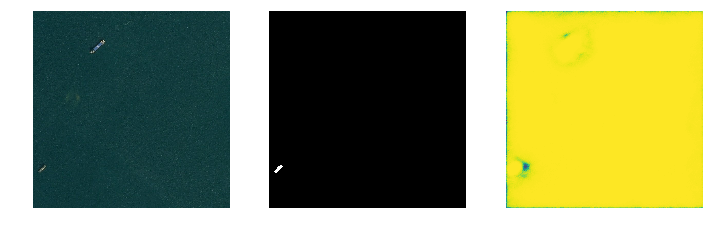

In [24]:
# After training with tversky loss
disp2.displayFiles(fileList, predImage_dir, target_dir, predMasks)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


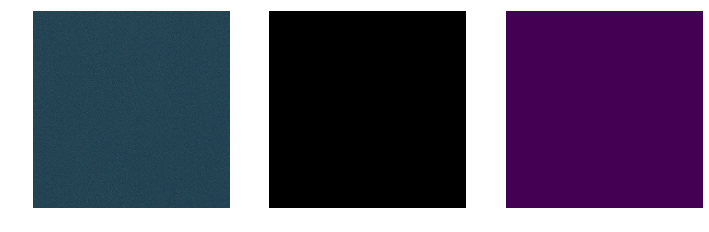

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


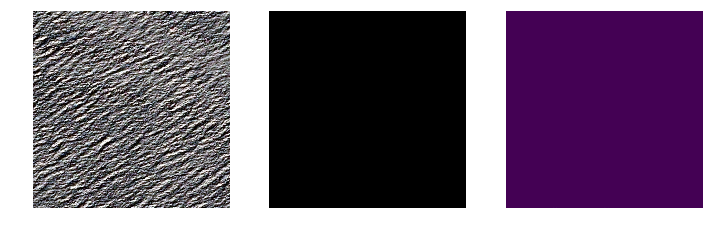

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


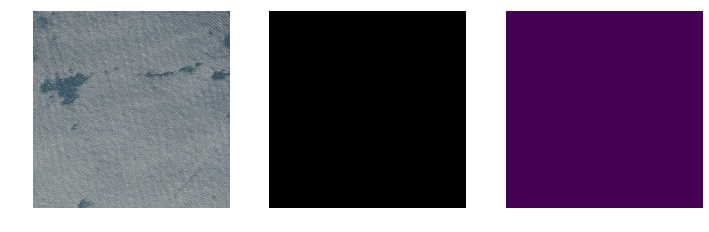

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


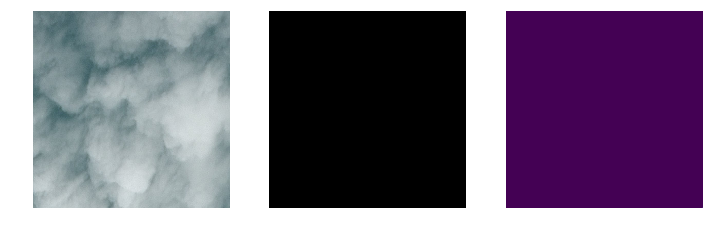

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


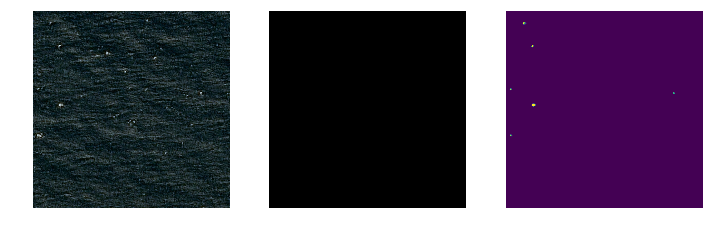

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


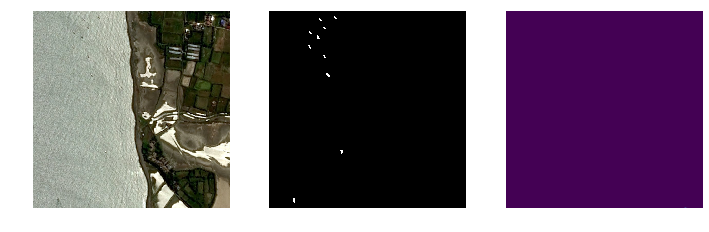

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


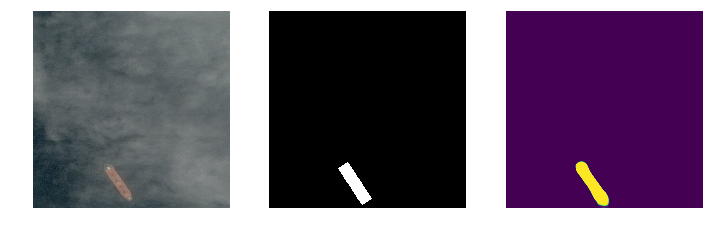

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


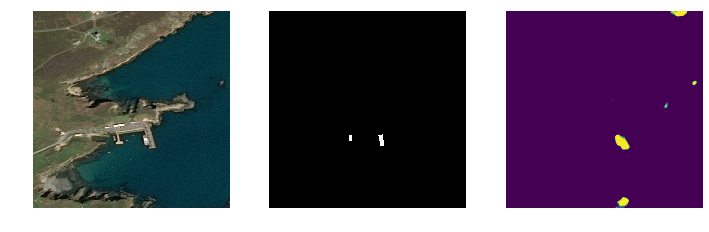

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


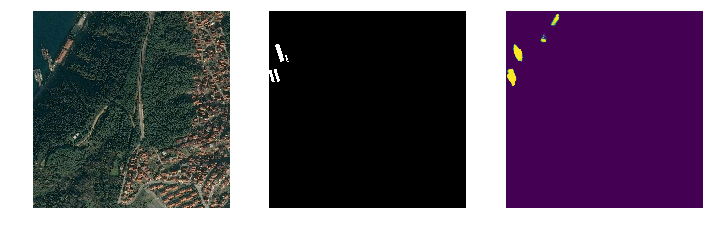

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


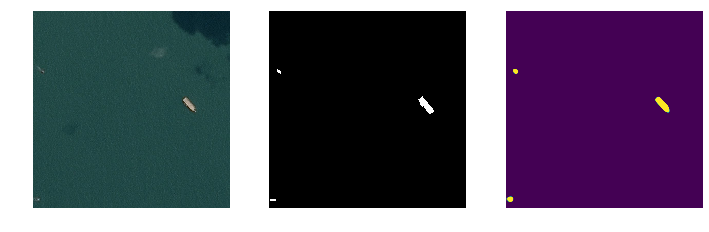

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


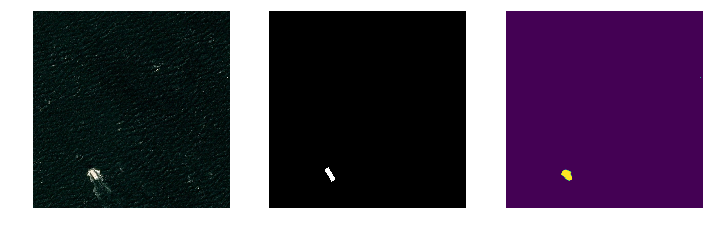

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


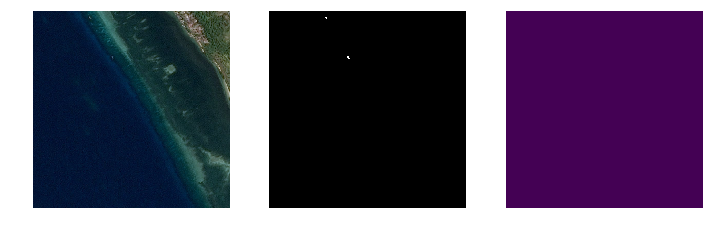

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


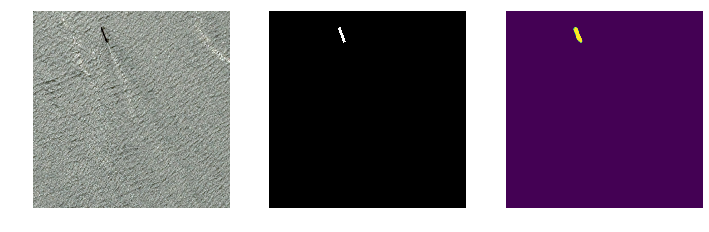

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


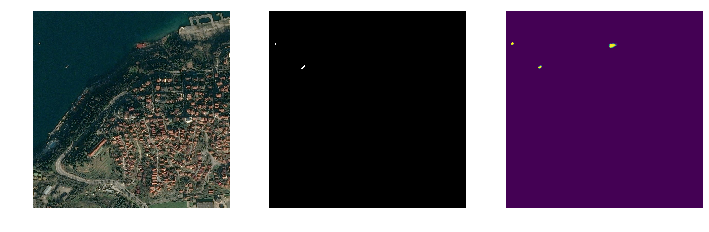

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


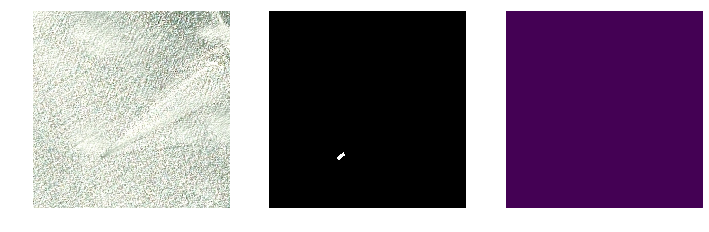

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


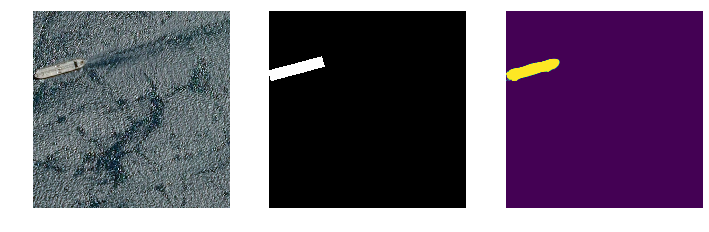

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


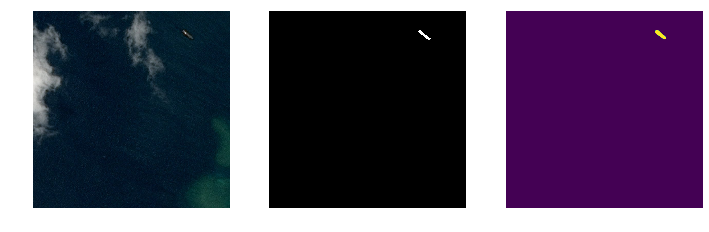

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


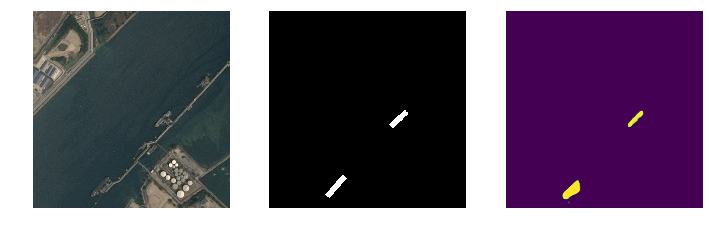

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


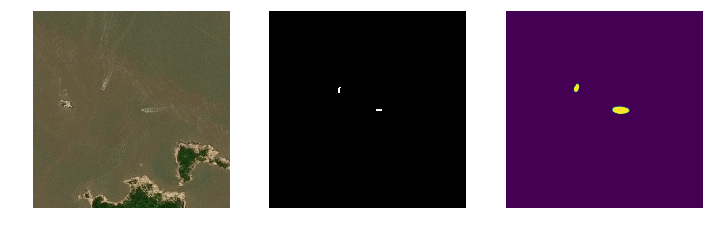

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


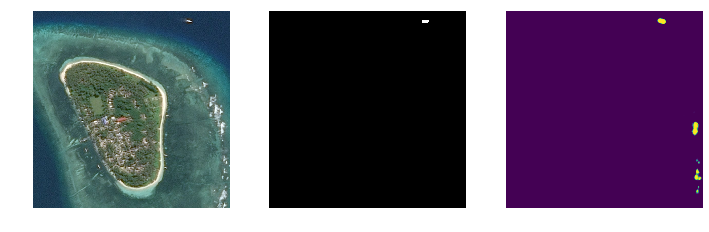

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


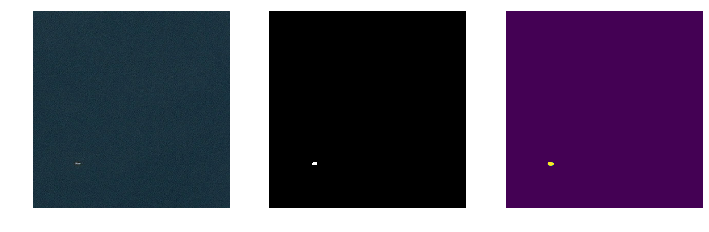

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


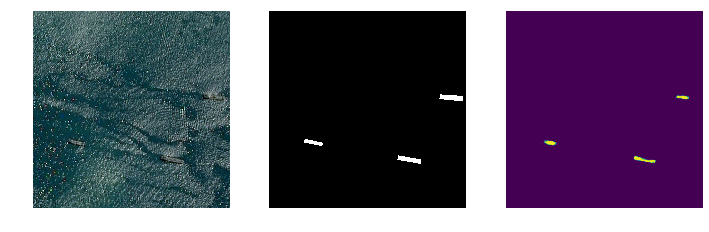

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


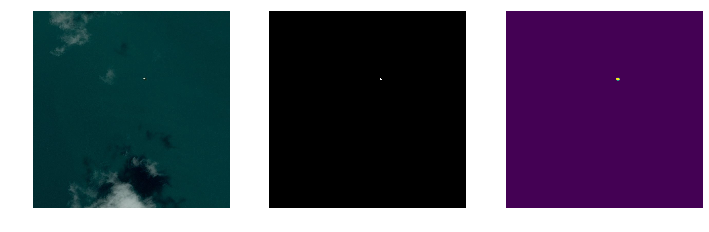

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


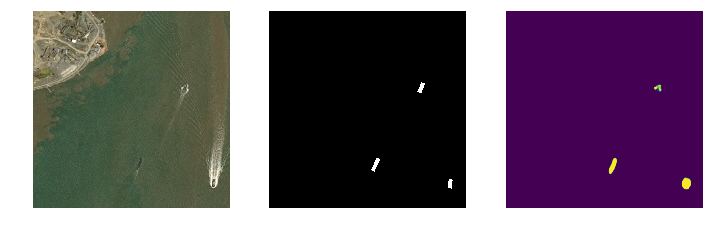

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


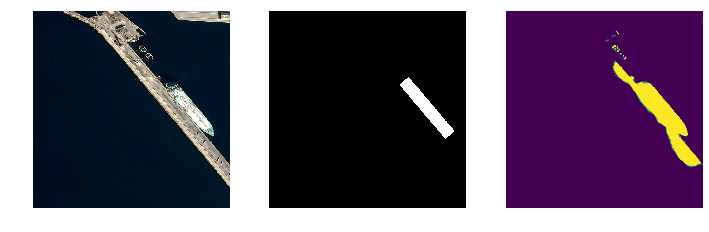

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


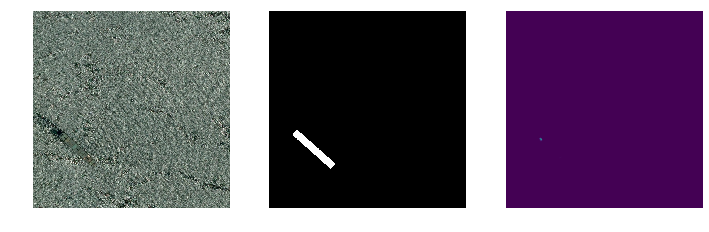

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


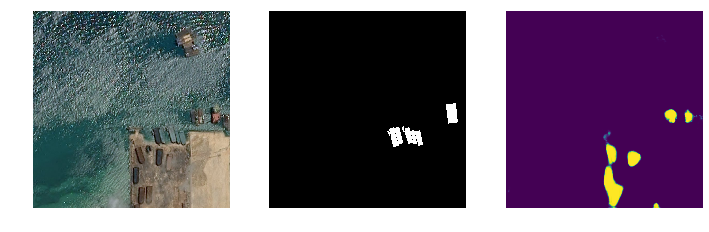

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


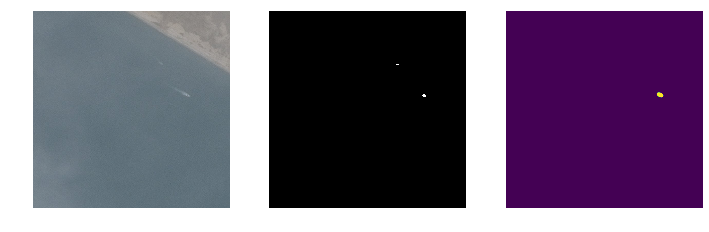

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


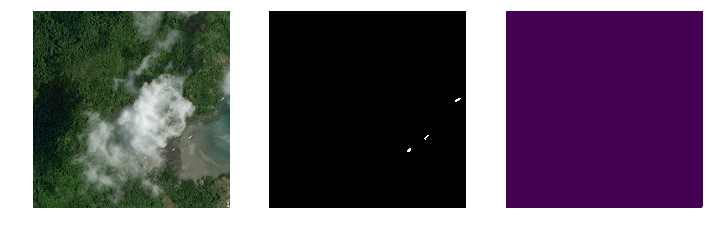

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


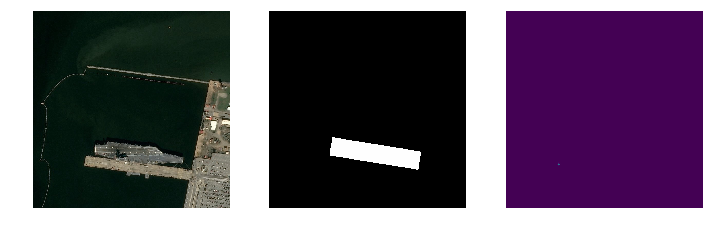

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


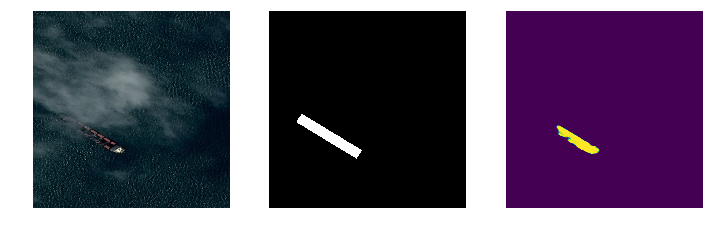

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


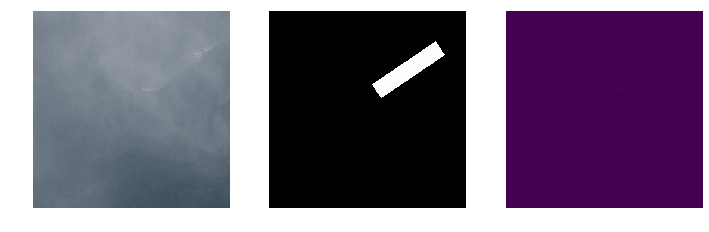

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


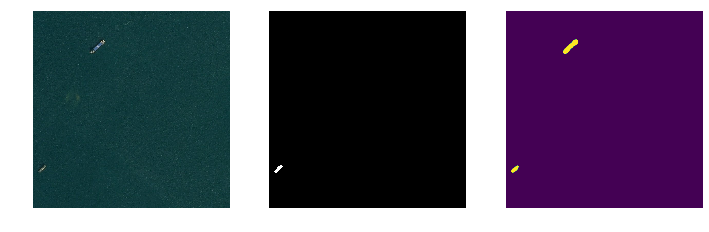

In [29]:
# Using focalTversky.tversky_loss
disp2.displayFiles(fileList, predImage_dir, target_dir, predMasks)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


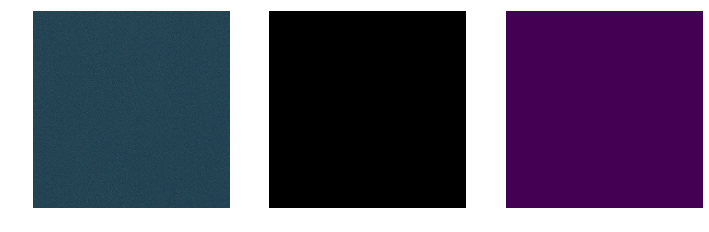

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


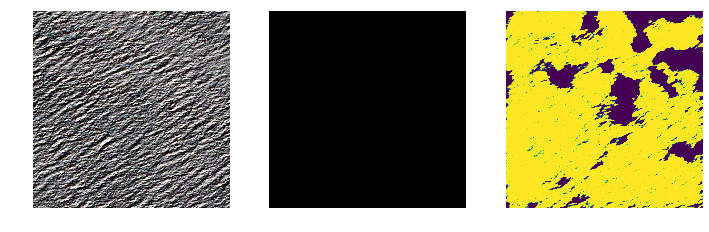

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


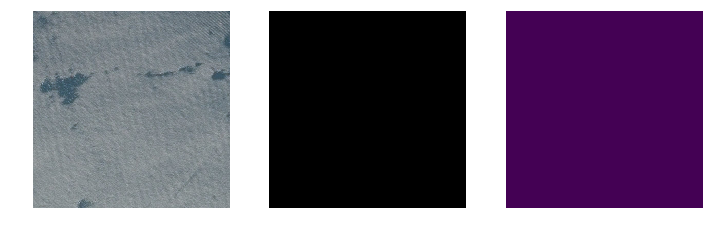

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


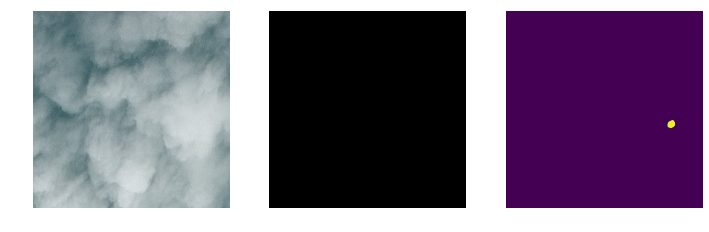

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


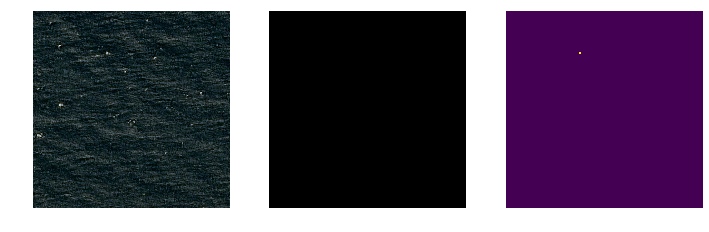

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


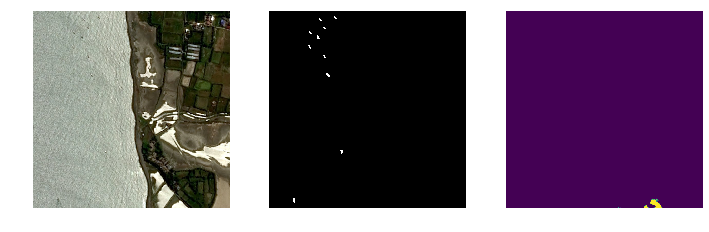

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


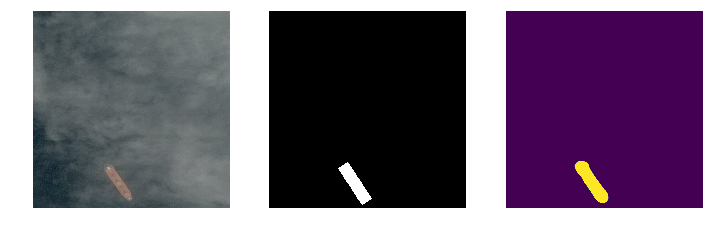

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


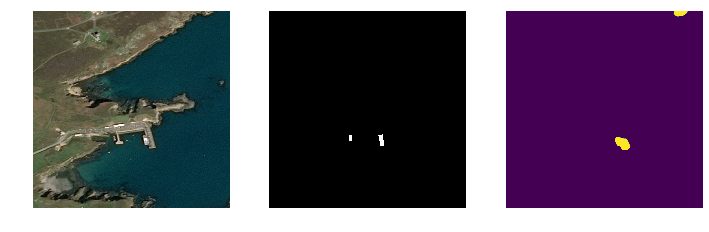

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


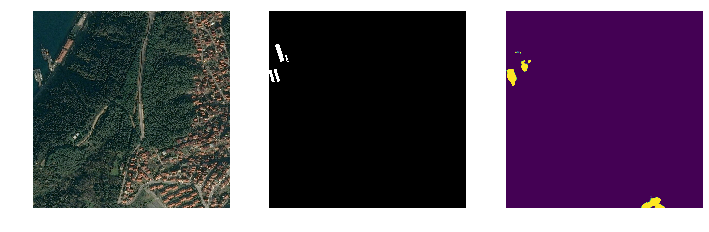

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


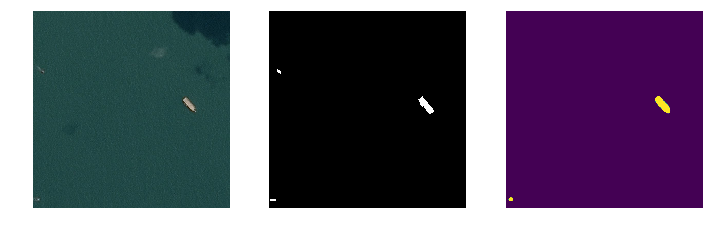

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


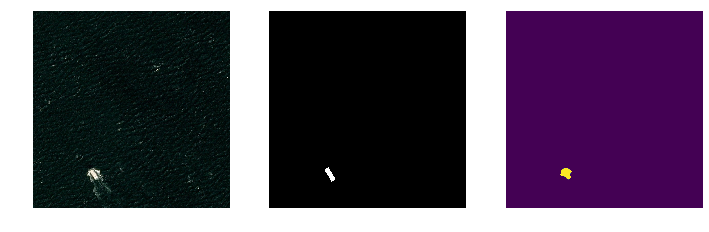

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


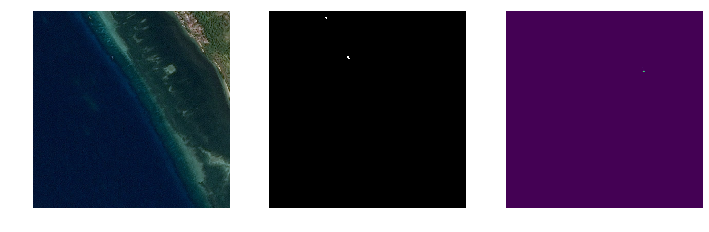

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


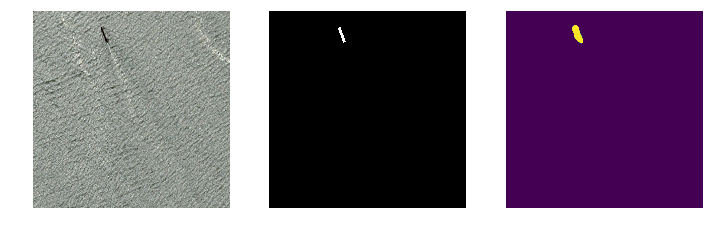

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


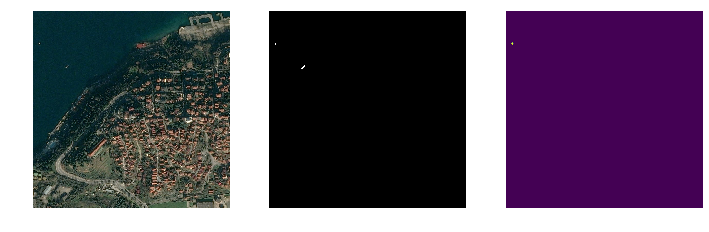

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


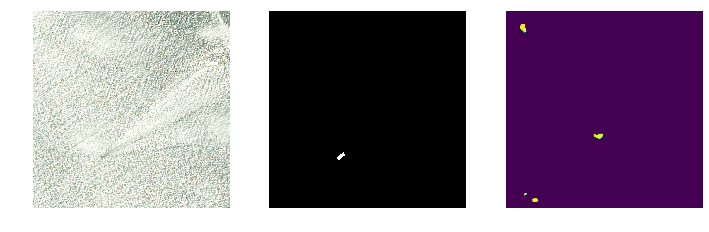

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


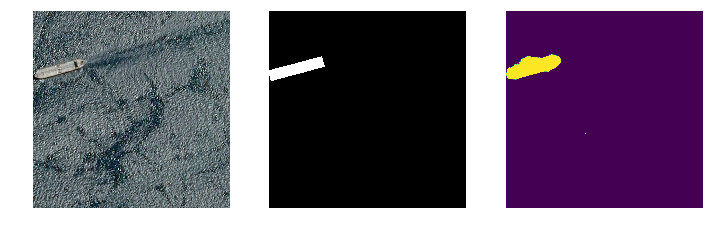

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


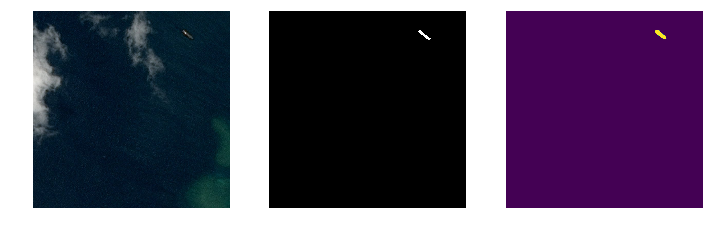

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


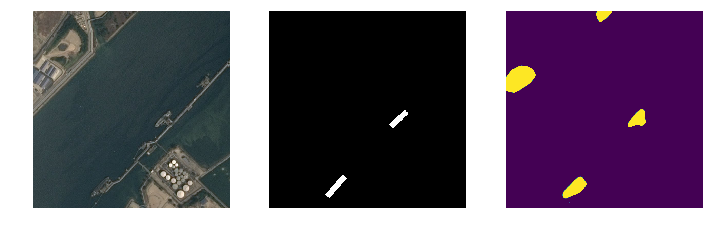

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


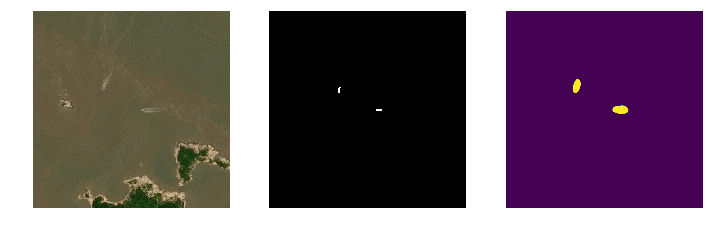

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


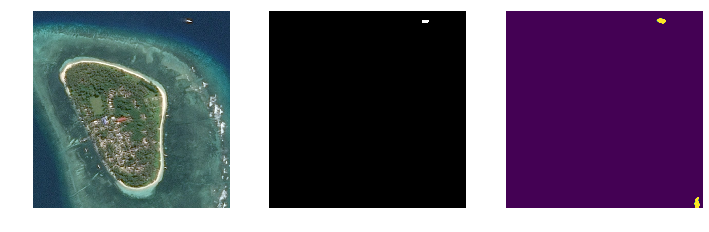

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


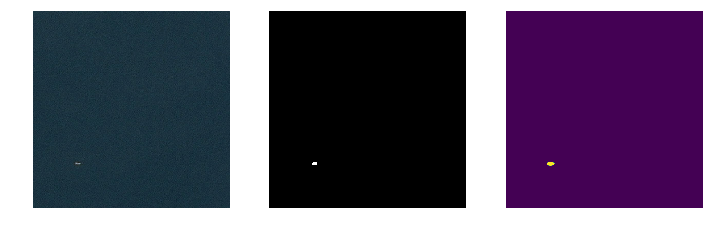

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


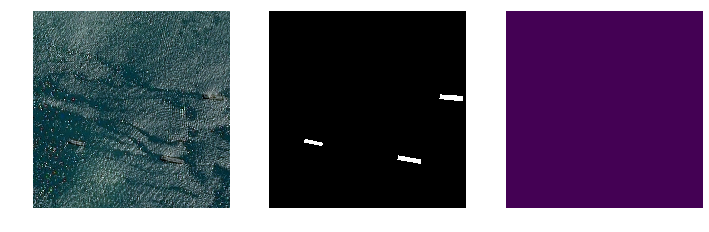

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


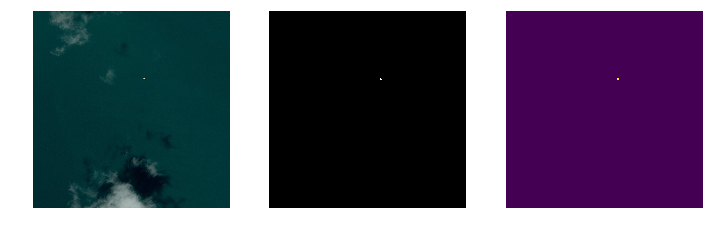

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


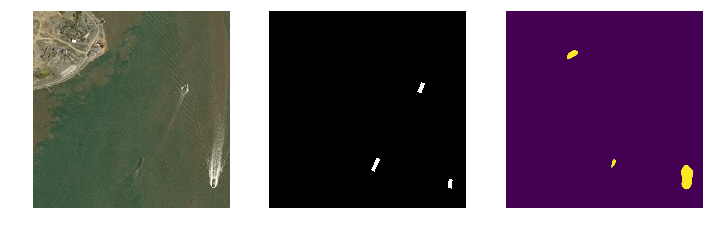

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


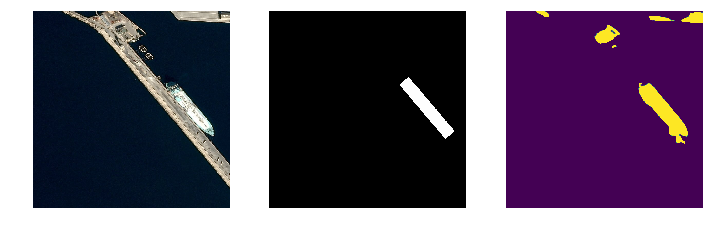

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


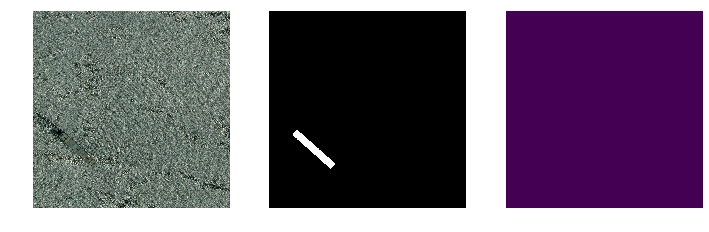

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


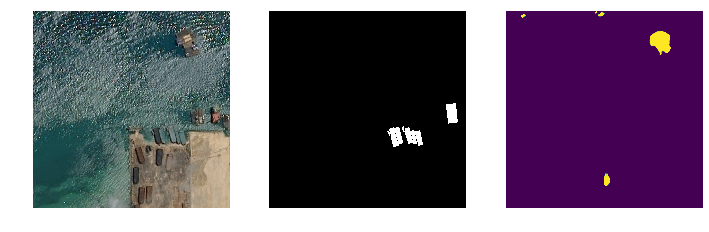

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


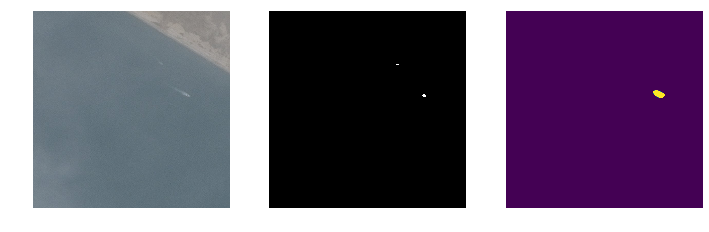

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


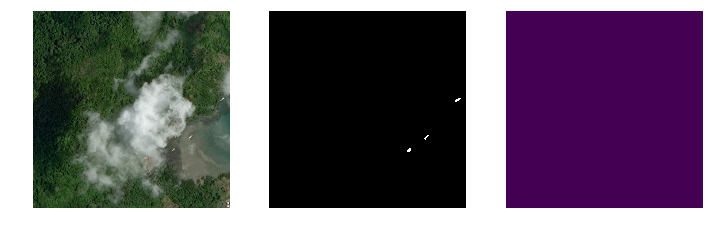

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


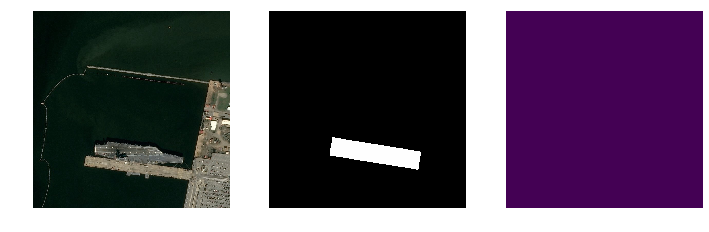

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


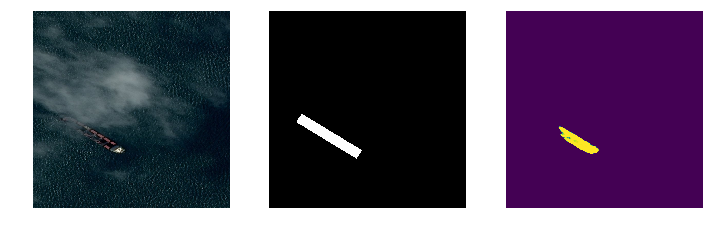

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


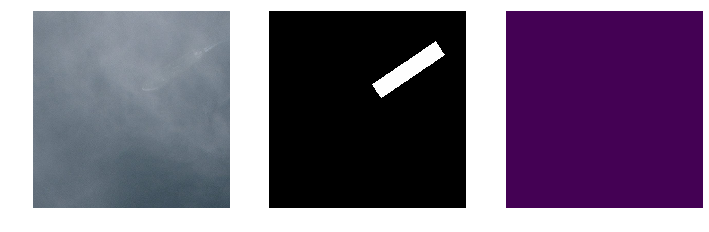

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


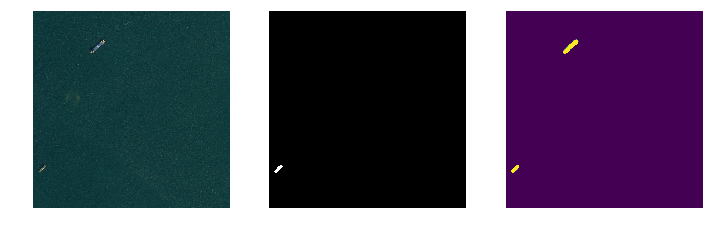

In [24]:
# 3 more epochs training using focalTversky.tversky_loss
disp2.displayFiles(fileList, predImage_dir, target_dir, predMasks)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


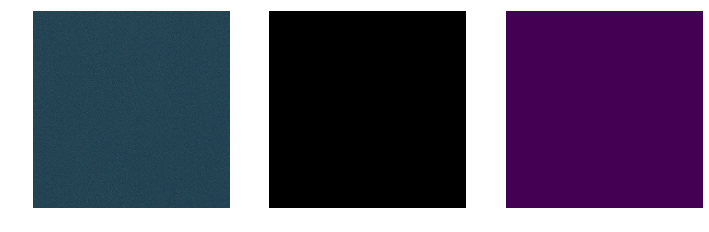

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


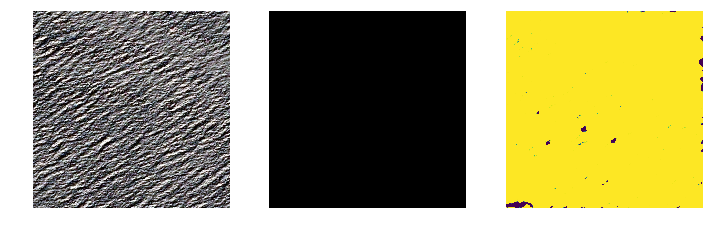

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


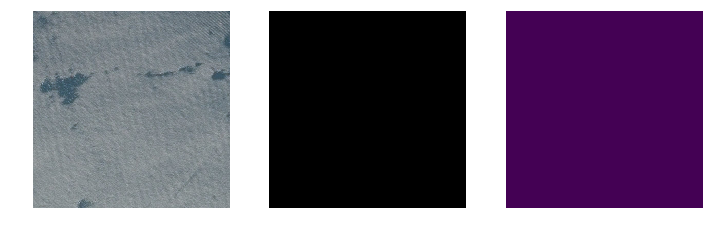

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


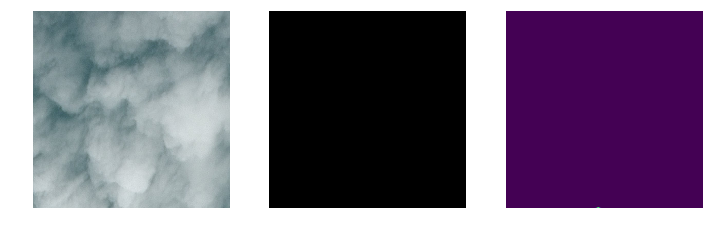

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


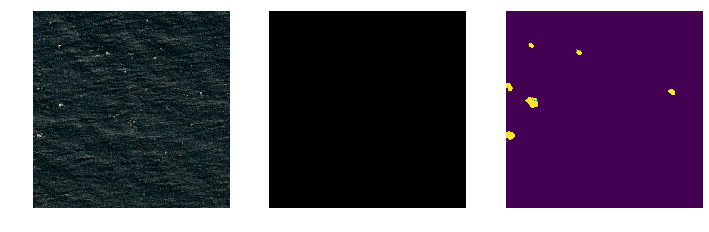

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


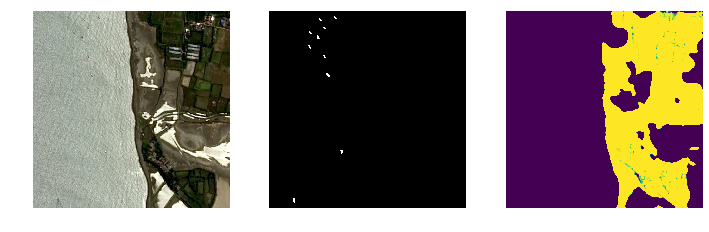

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


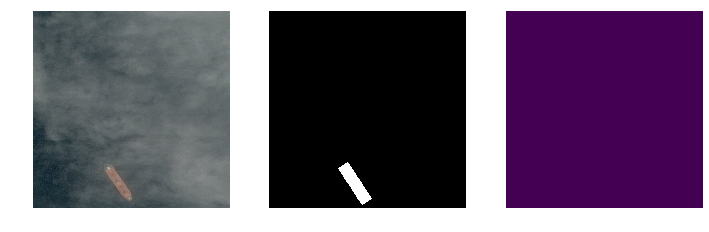

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


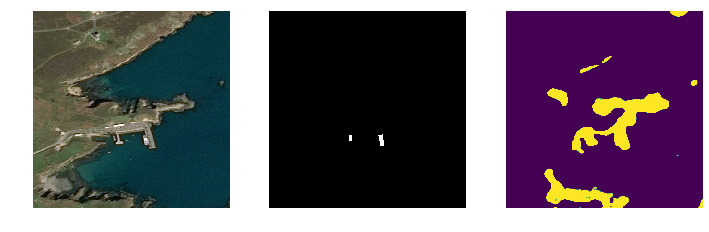

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


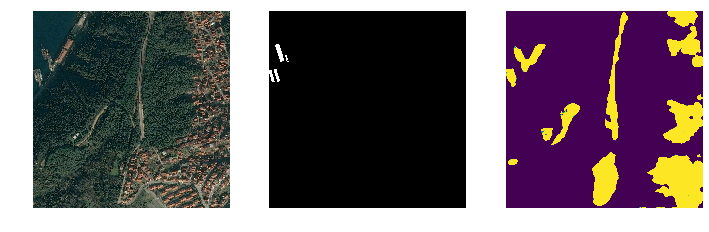

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


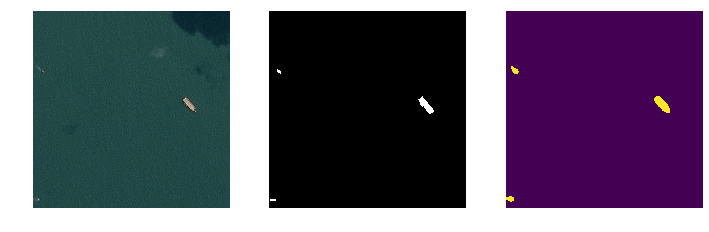

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


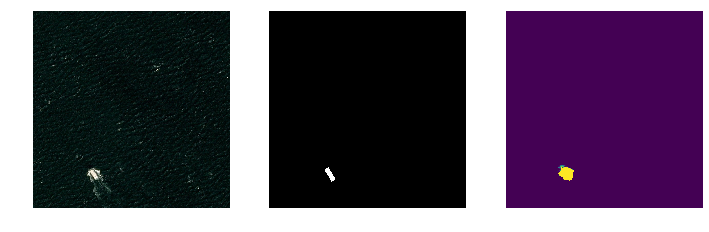

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


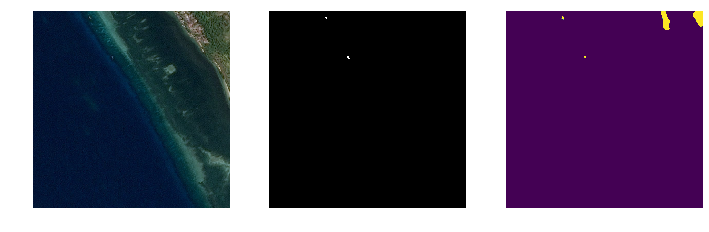

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


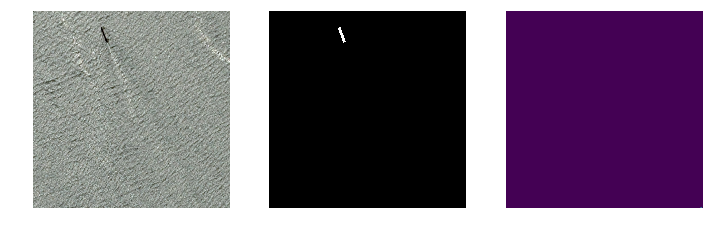

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


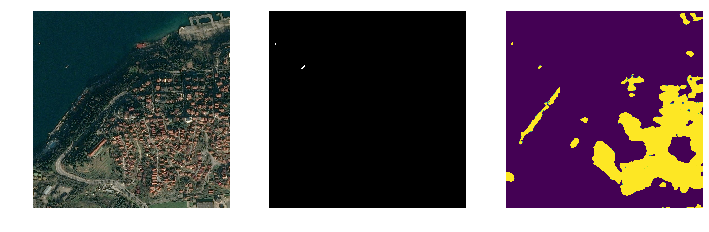

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


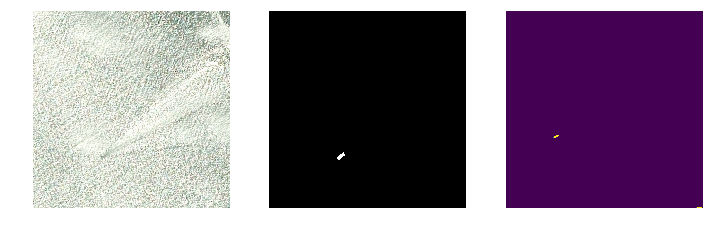

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


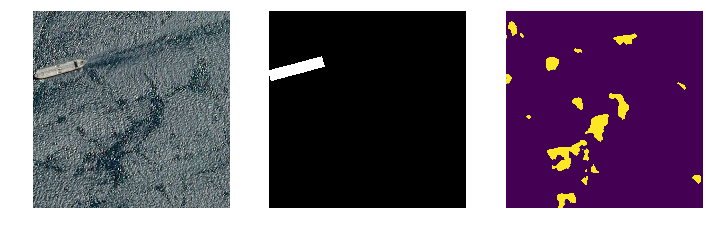

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


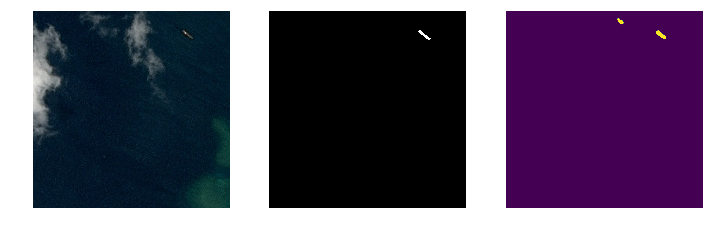

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


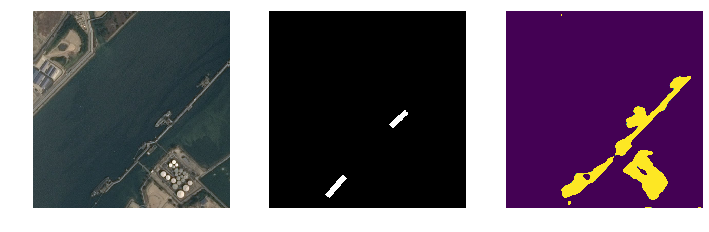

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


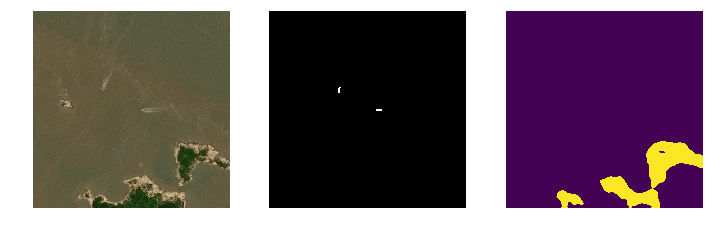

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


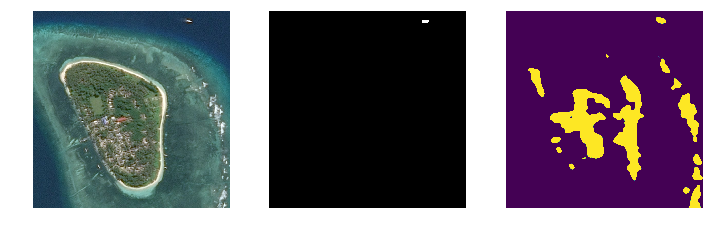

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


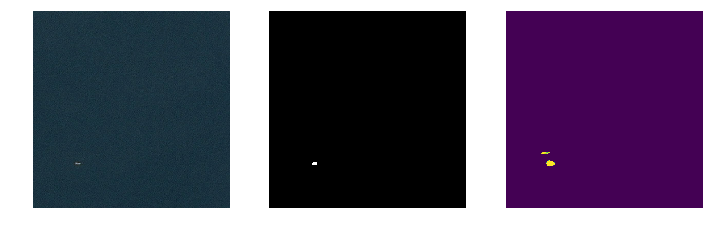

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


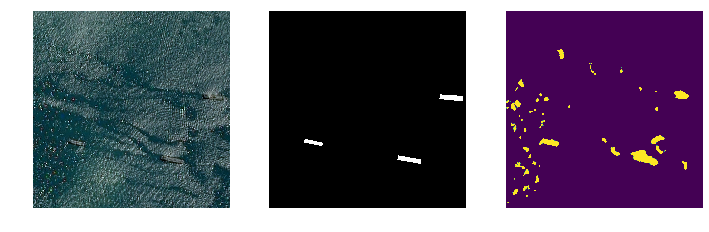

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


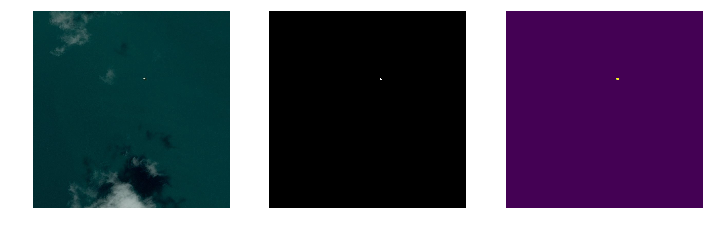

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


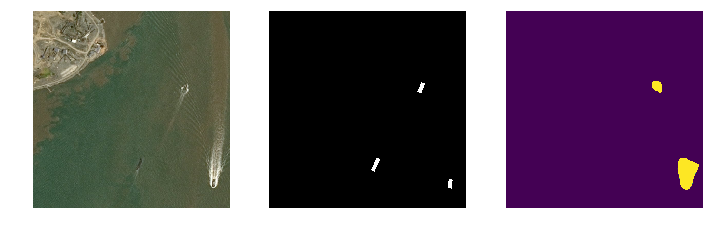

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


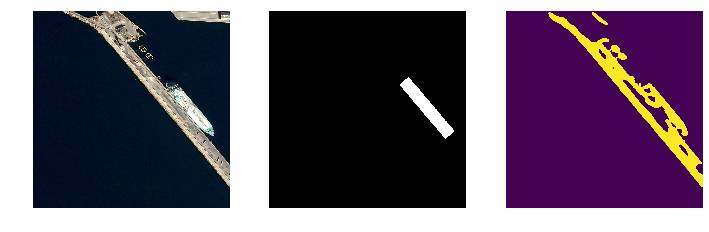

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


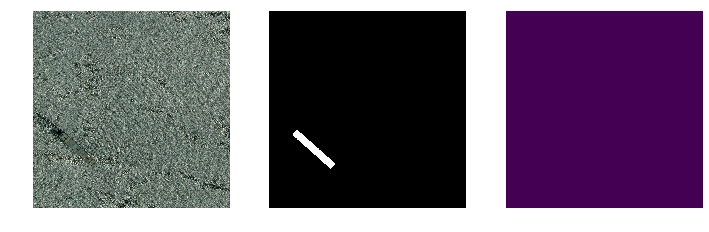

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


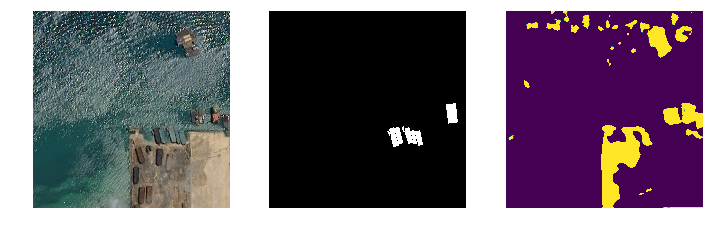

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


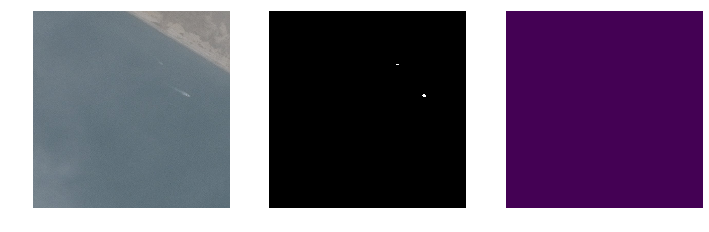

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


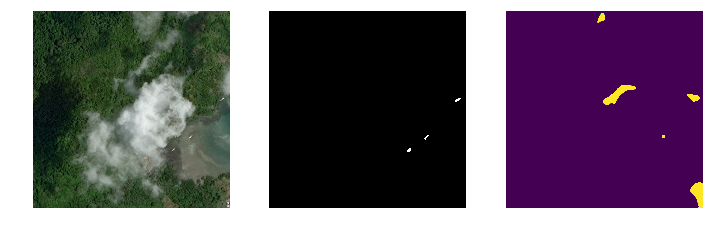

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


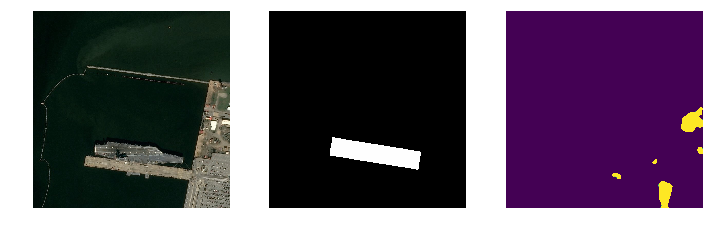

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


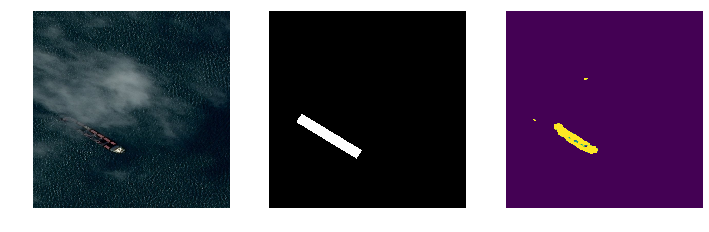

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


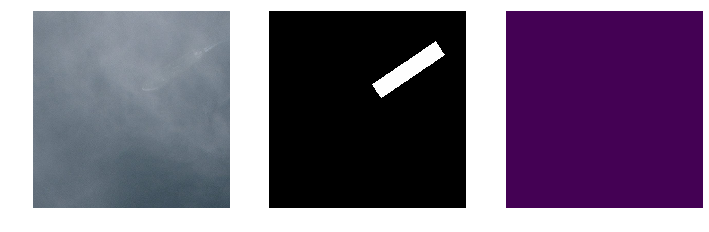

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


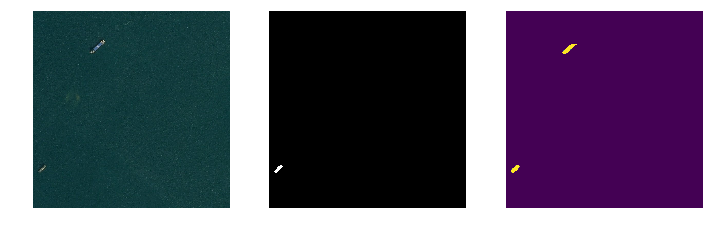

In [25]:
# 3 more epochs training using focalTversky.focal_tversky
disp2.displayFiles(fileList, predImage_dir, target_dir, predMasks)